# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return nn.functional.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [14]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [15]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.3624288429021836, discriminator loss: 0.22630527905374764


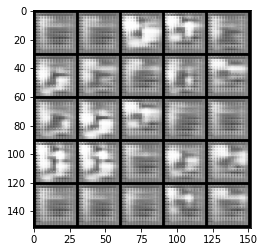

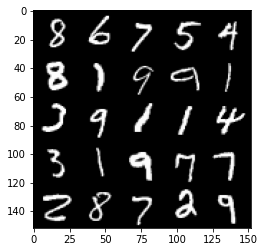

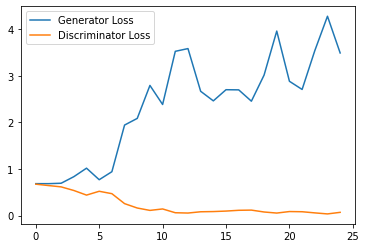

Step 1000: Generator loss: 4.669570823192596, discriminator loss: 0.05530303627159446


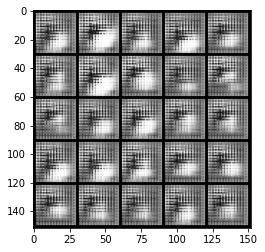

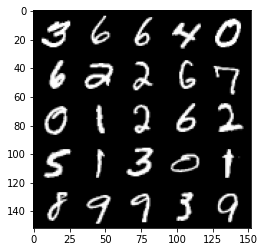

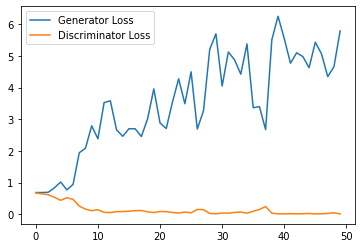

Step 1500: Generator loss: 5.770176221847534, discriminator loss: 0.021341263751033693


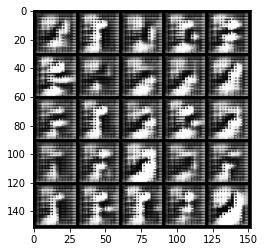

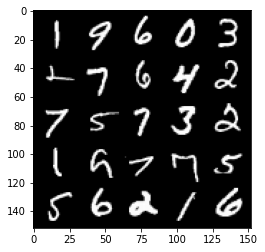

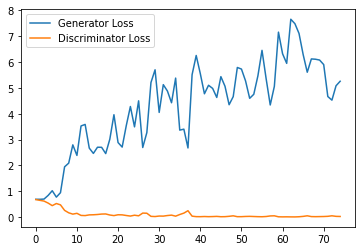

Step 2000: Generator loss: 5.215064221858978, discriminator loss: 0.03439178360905498


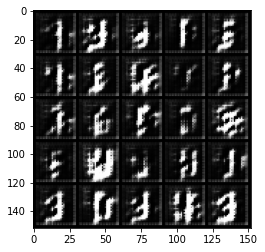

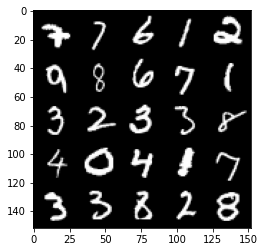

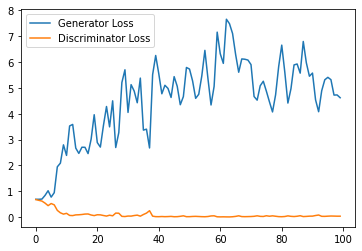

Step 2500: Generator loss: 4.166474514484405, discriminator loss: 0.08616595680825412


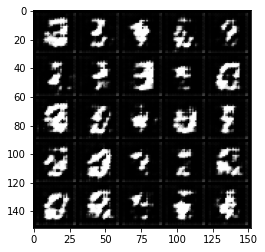

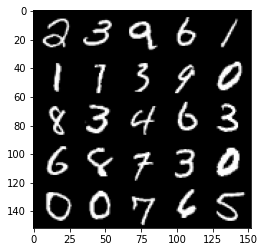

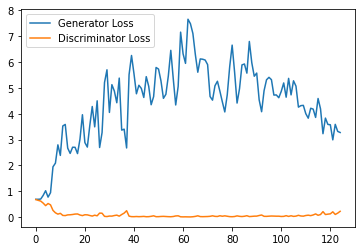

Step 3000: Generator loss: 3.1766590394973755, discriminator loss: 0.16863717243820428


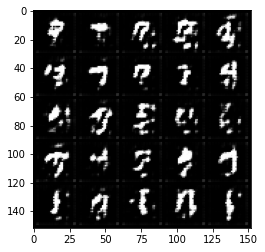

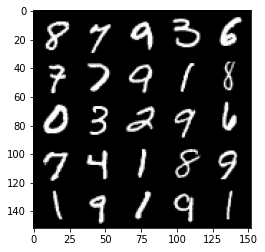

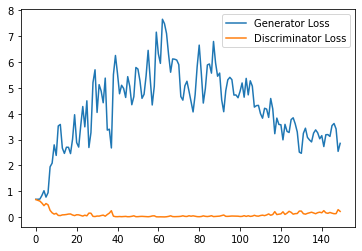

Step 3500: Generator loss: 3.0197779936790465, discriminator loss: 0.19472848030924797


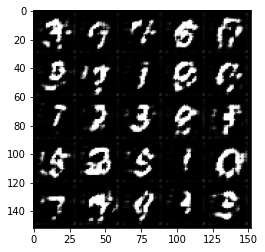

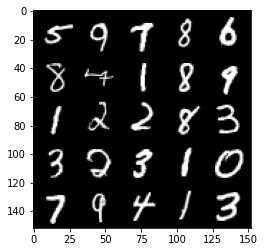

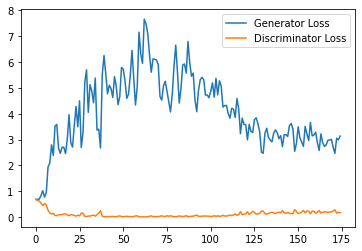

Step 4000: Generator loss: 2.500865428447723, discriminator loss: 0.25350229668617247


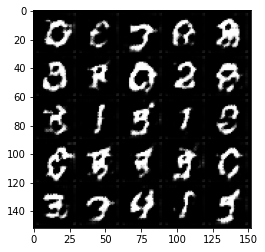

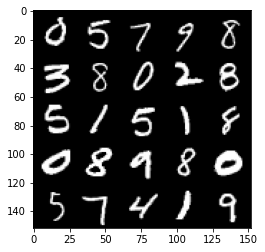

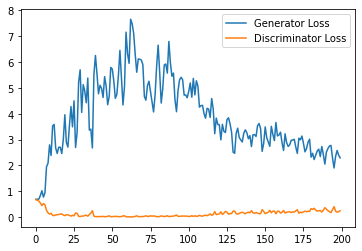

Step 4500: Generator loss: 2.411760065317154, discriminator loss: 0.28169840151071546


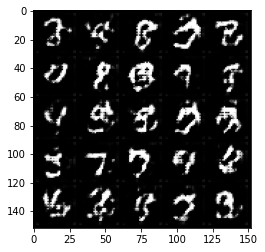

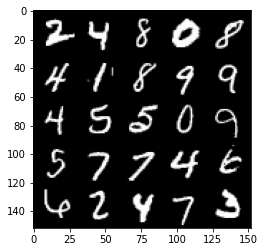

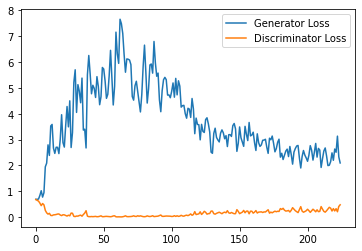

Step 5000: Generator loss: 2.1634650366306305, discriminator loss: 0.3251775932610035


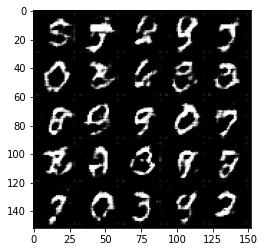

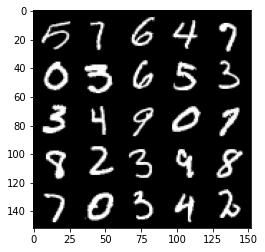

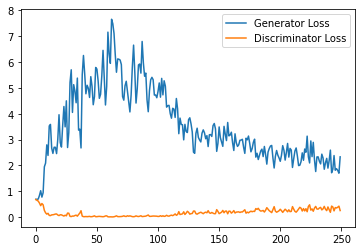

Step 5500: Generator loss: 1.9794095714092255, discriminator loss: 0.3490025517642498


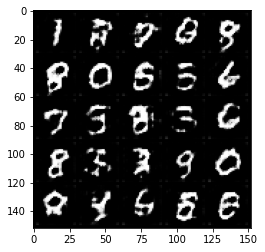

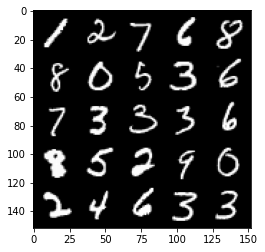

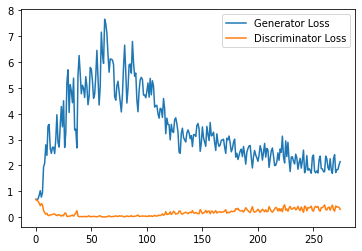

Step 6000: Generator loss: 1.8017215464115144, discriminator loss: 0.36156170412898064


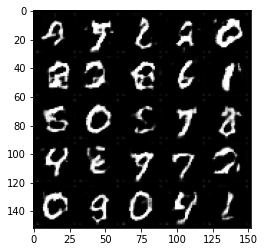

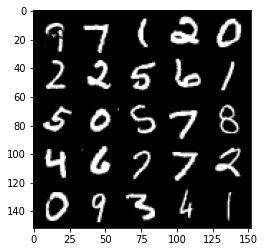

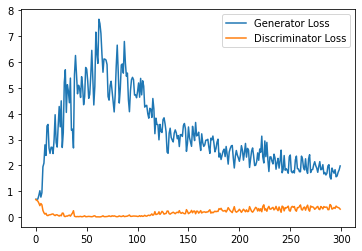

Step 6500: Generator loss: 1.8496601855754853, discriminator loss: 0.39938611996173856


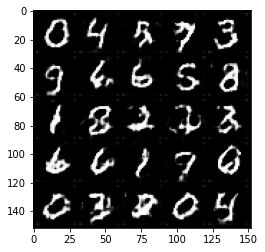

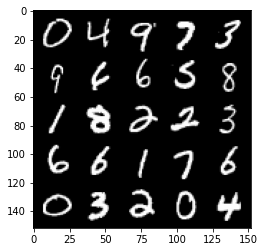

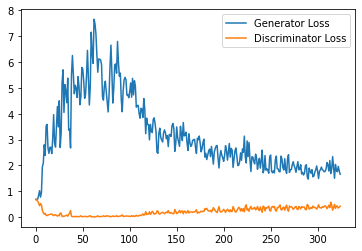

Step 7000: Generator loss: 1.6360821170806885, discriminator loss: 0.42400383913517


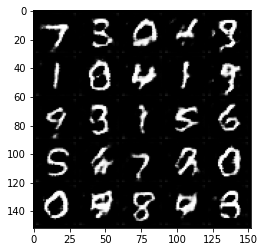

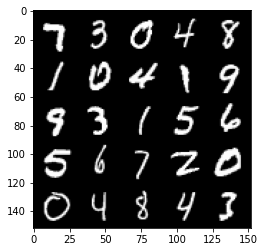

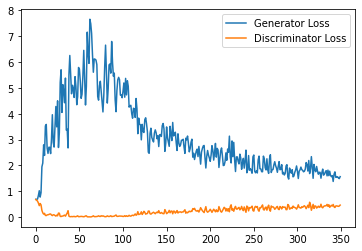

Step 7500: Generator loss: 1.5579652225971221, discriminator loss: 0.44635092771053314


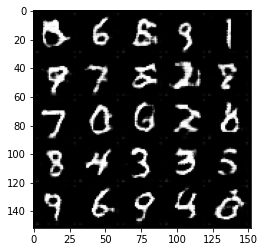

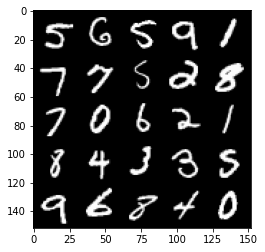

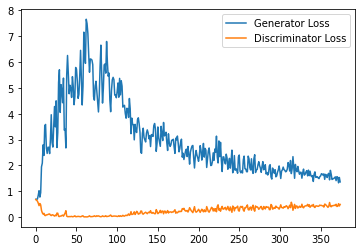

Step 8000: Generator loss: 1.5087146054506302, discriminator loss: 0.463416877925396


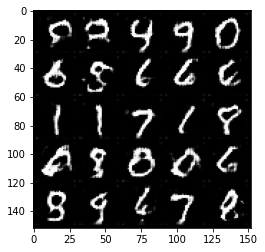

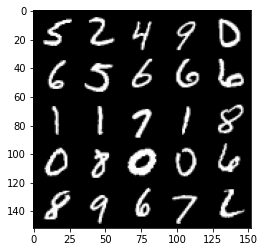

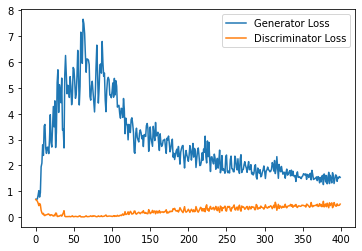

Step 8500: Generator loss: 1.4616944236755371, discriminator loss: 0.48218087166547774


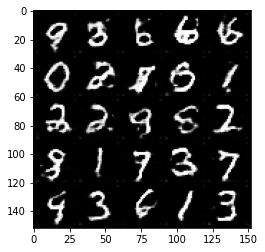

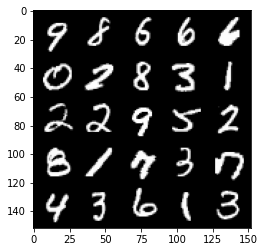

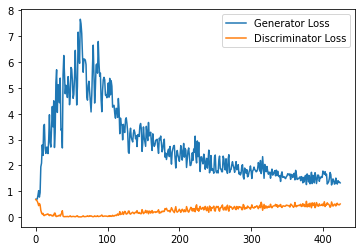

Step 9000: Generator loss: 1.462772096633911, discriminator loss: 0.4908973758220673


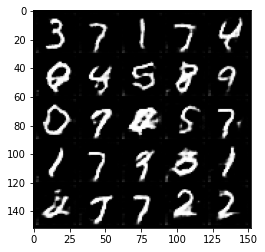

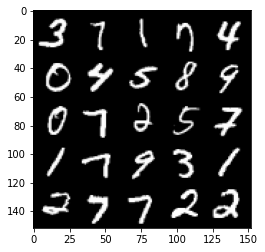

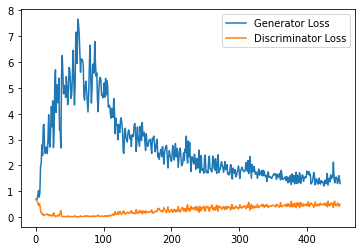

Step 9500: Generator loss: 1.3611536625623704, discriminator loss: 0.4964024121761322


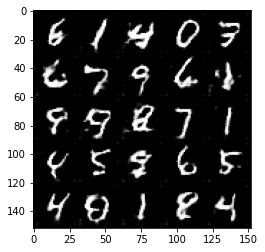

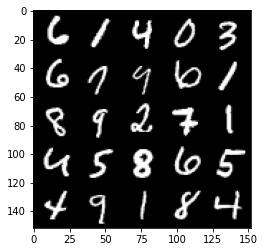

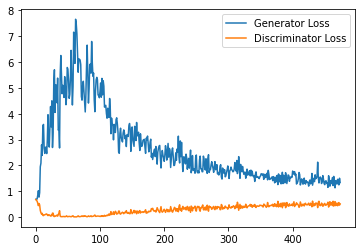

Step 10000: Generator loss: 1.4012718224525451, discriminator loss: 0.4874637753367424


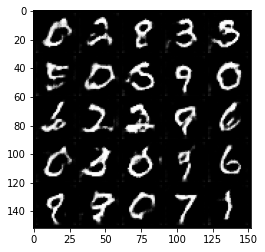

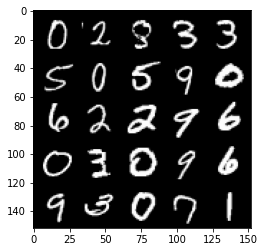

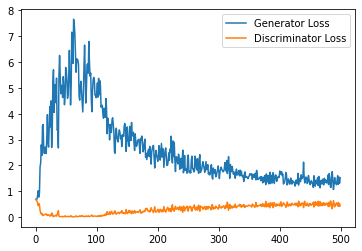

Step 10500: Generator loss: 1.3776334558725356, discriminator loss: 0.4965884150862694


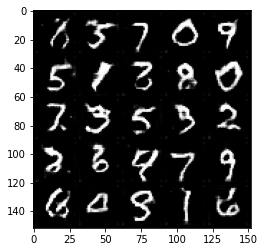

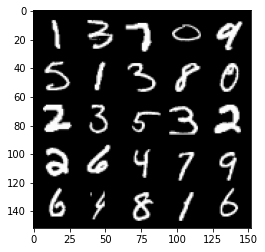

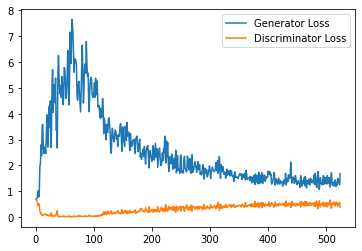

Step 11000: Generator loss: 1.404496054649353, discriminator loss: 0.5012632786035538


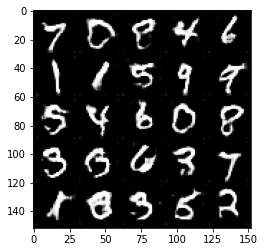

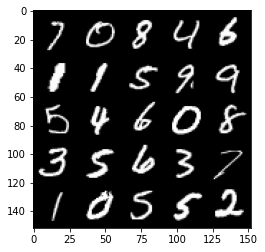

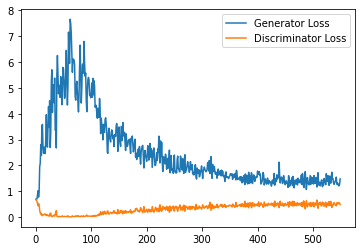

Step 11500: Generator loss: 1.2997967640161514, discriminator loss: 0.5152719578742981


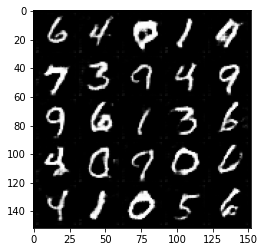

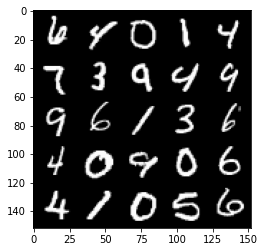

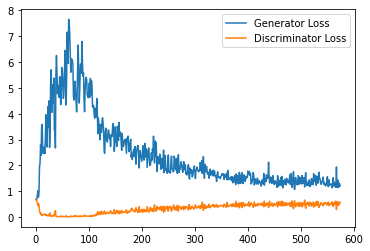

Step 12000: Generator loss: 1.3517367125749589, discriminator loss: 0.522670136809349


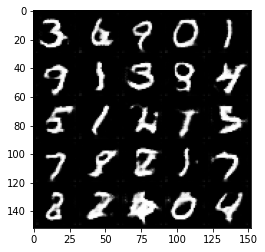

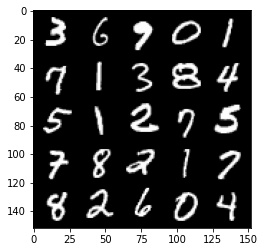

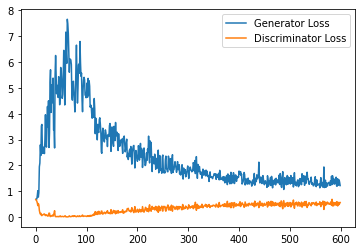

Step 12500: Generator loss: 1.2807654963731765, discriminator loss: 0.523099908053875


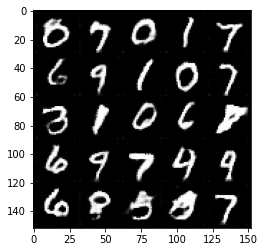

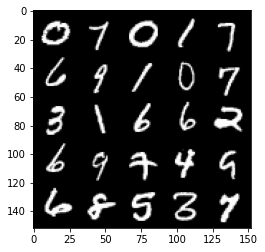

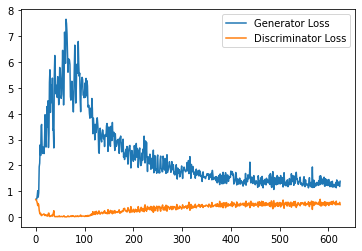

Step 13000: Generator loss: 1.2625438767671584, discriminator loss: 0.5262172629833222


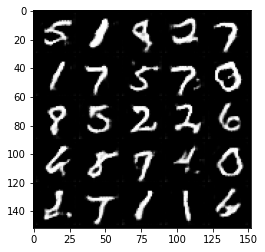

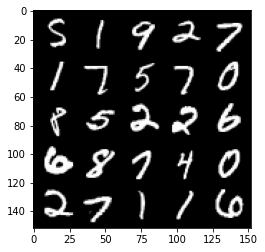

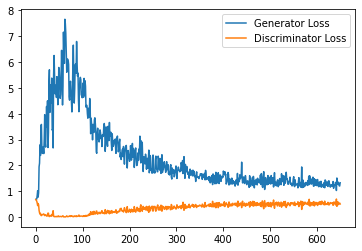

Step 13500: Generator loss: 1.2480758250951767, discriminator loss: 0.5284846048355103


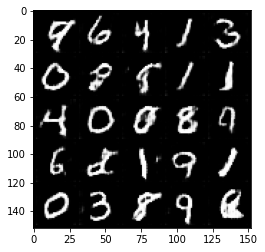

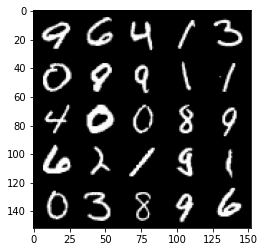

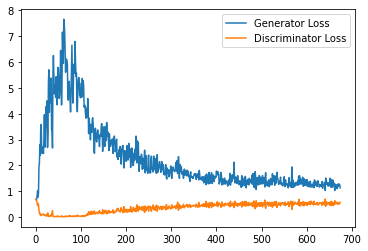

Step 14000: Generator loss: 1.249797201871872, discriminator loss: 0.539291831612587


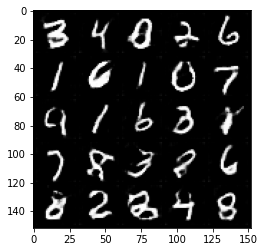

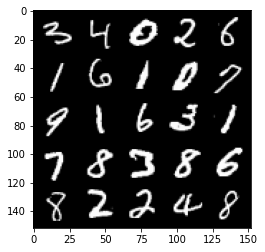

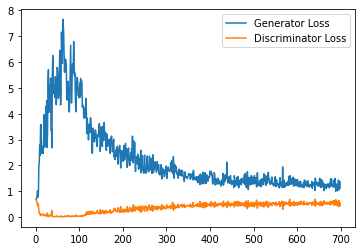

Step 14500: Generator loss: 1.2093899582624434, discriminator loss: 0.5358804133534432


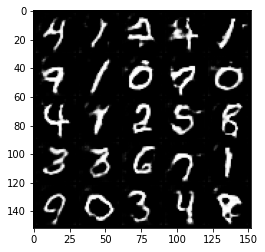

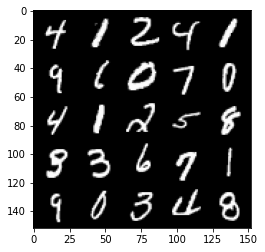

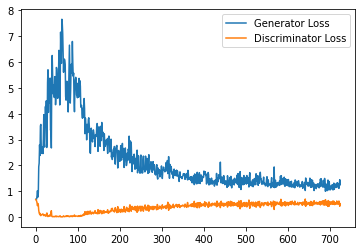

Step 15000: Generator loss: 1.2332342084646224, discriminator loss: 0.5355204365253449


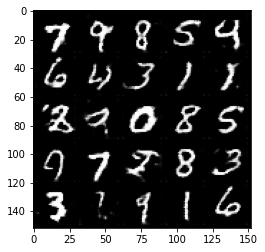

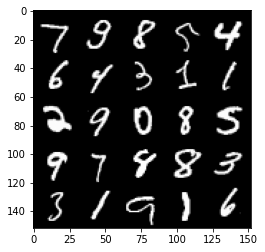

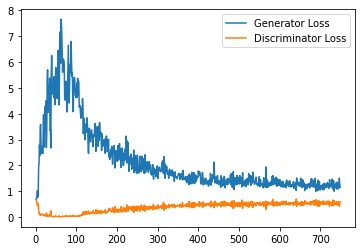

Step 15500: Generator loss: 1.211825149655342, discriminator loss: 0.5421001291275025


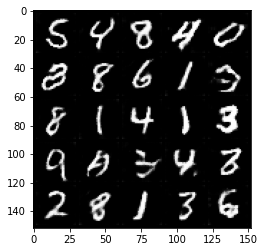

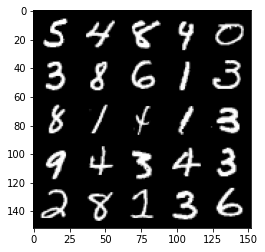

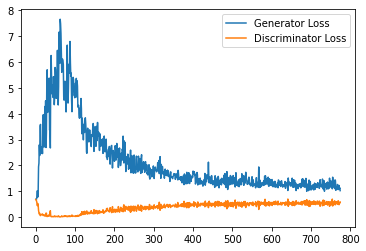

Step 16000: Generator loss: 1.1690122462511063, discriminator loss: 0.5489702934622764


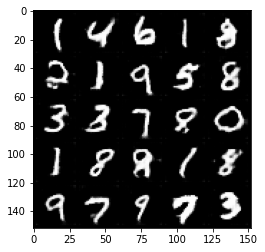

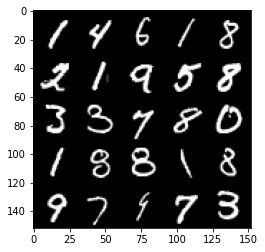

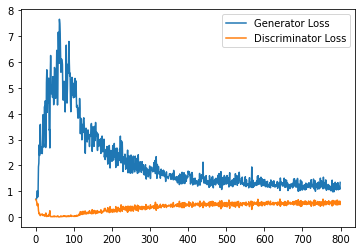

Step 16500: Generator loss: 1.1762088471651078, discriminator loss: 0.545738388478756


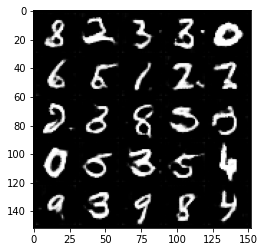

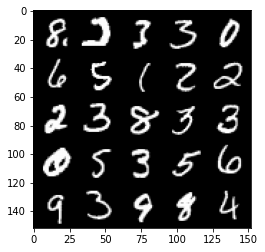

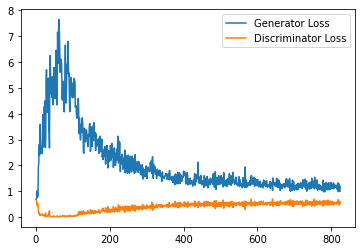

Step 17000: Generator loss: 1.15241006731987, discriminator loss: 0.5446554461717605


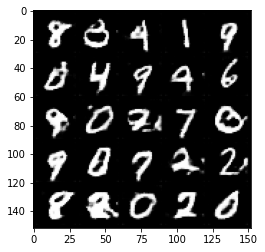

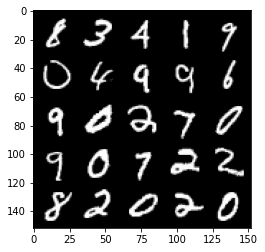

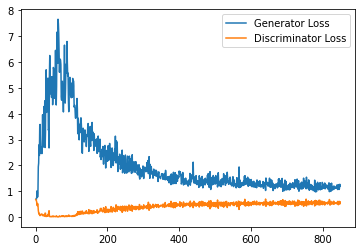

Step 17500: Generator loss: 1.1901472177505492, discriminator loss: 0.55176474827528


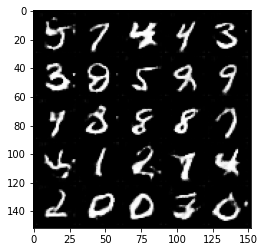

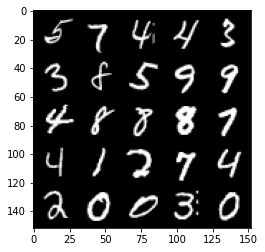

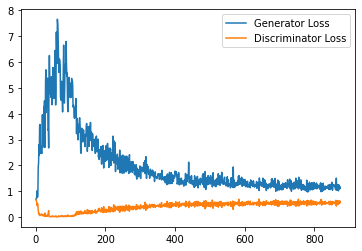

Step 18000: Generator loss: 1.1462060290575027, discriminator loss: 0.5496211906671524


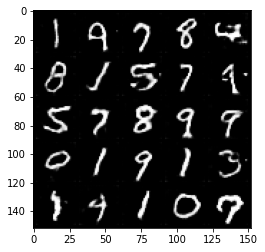

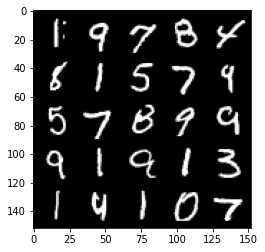

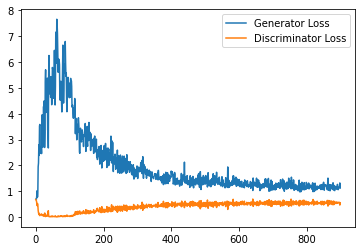

Step 18500: Generator loss: 1.1635846675634385, discriminator loss: 0.5436818378567696


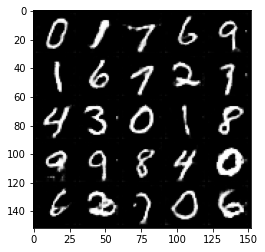

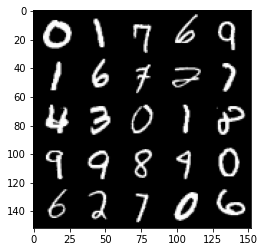

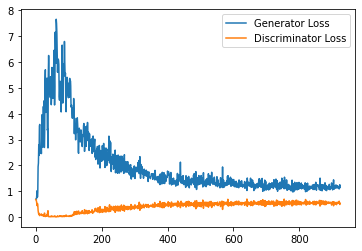

Step 19000: Generator loss: 1.1398676491975783, discriminator loss: 0.5470145258903504


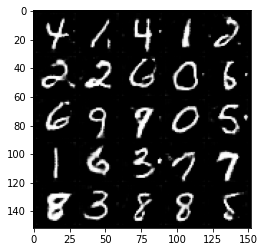

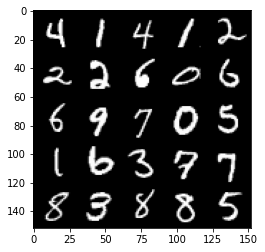

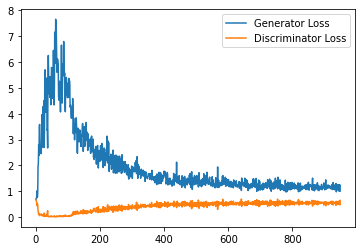

Step 19500: Generator loss: 1.1291136343479156, discriminator loss: 0.5462913933992386


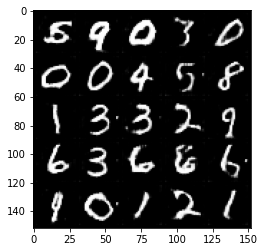

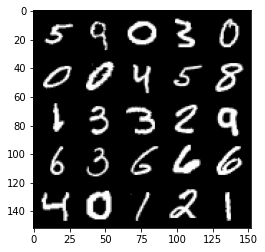

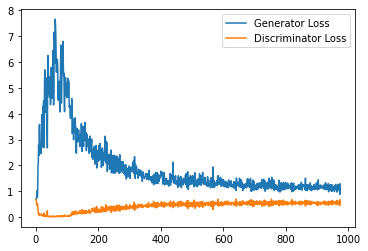

Step 20000: Generator loss: 1.1471877390146255, discriminator loss: 0.5499133639931679


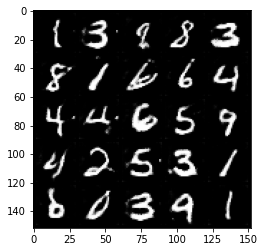

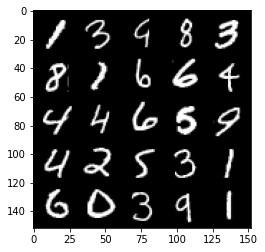

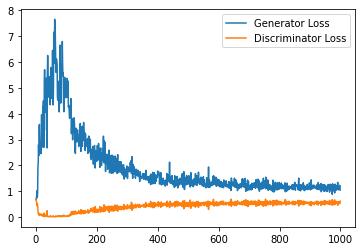

Step 20500: Generator loss: 1.1589810330867767, discriminator loss: 0.5533612959980965


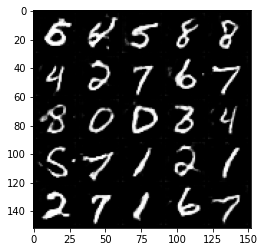

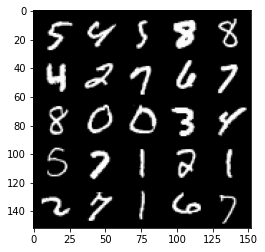

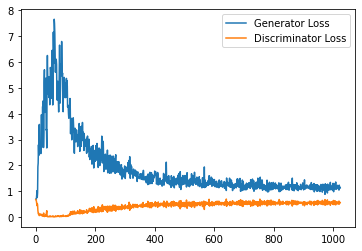

Step 21000: Generator loss: 1.131195386648178, discriminator loss: 0.5514039600491524


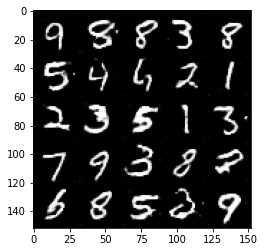

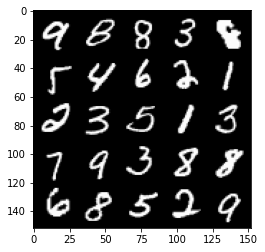

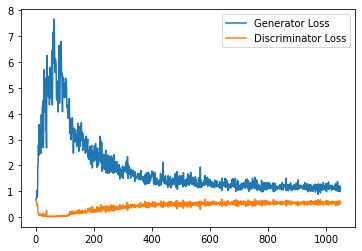

Step 21500: Generator loss: 1.1083444495201111, discriminator loss: 0.5553700011372567


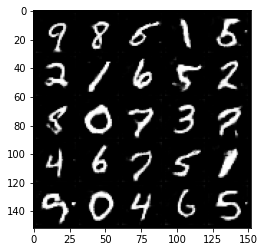

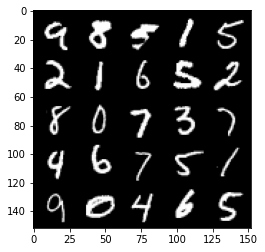

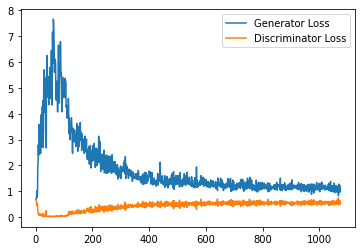

Step 22000: Generator loss: 1.1504244629144669, discriminator loss: 0.5562273622751236


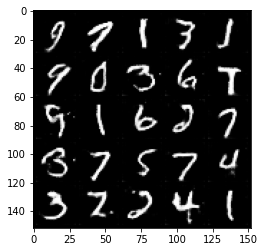

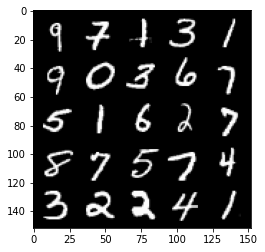

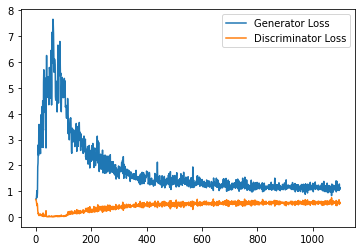

Step 22500: Generator loss: 1.109222798705101, discriminator loss: 0.5636253980994225


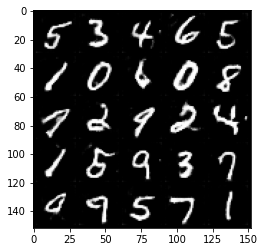

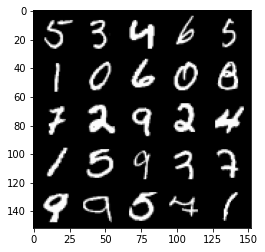

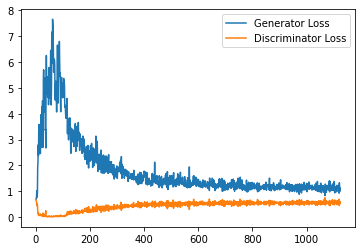

Step 23000: Generator loss: 1.0939651505947112, discriminator loss: 0.5629467380642891


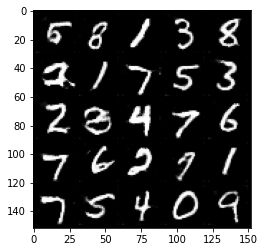

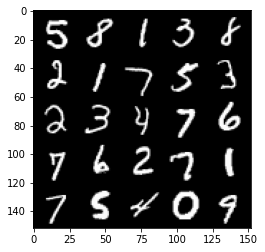

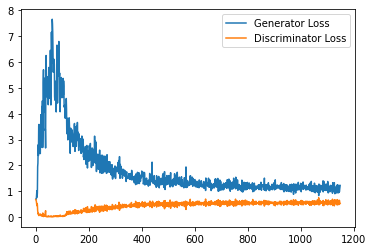

Step 23500: Generator loss: 1.120650432229042, discriminator loss: 0.5630671590566635


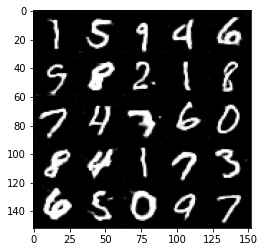

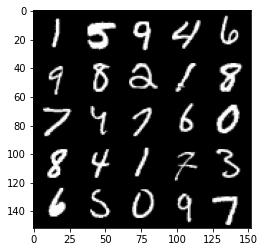

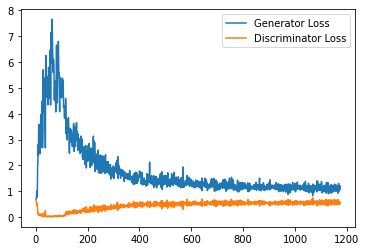

Step 24000: Generator loss: 1.1234523371458054, discriminator loss: 0.5641393141150475


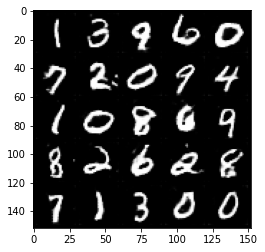

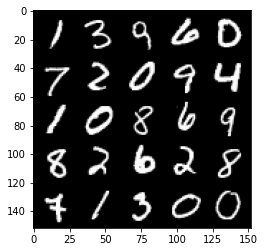

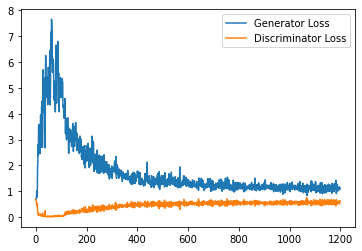

Step 24500: Generator loss: 1.1080006738901138, discriminator loss: 0.560813291311264


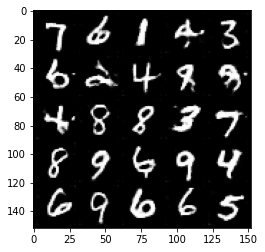

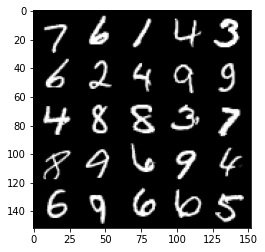

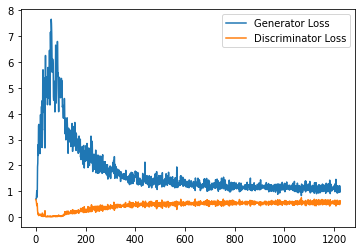

Step 25000: Generator loss: 1.1009690947532653, discriminator loss: 0.5579477537870408


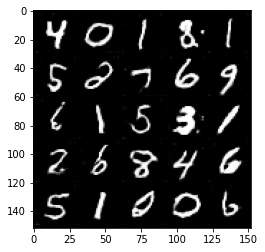

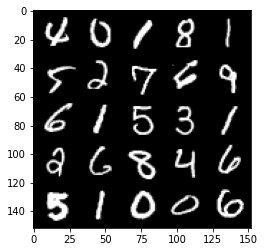

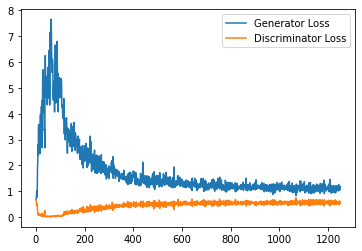

Step 25500: Generator loss: 1.1235392150878907, discriminator loss: 0.561810859143734


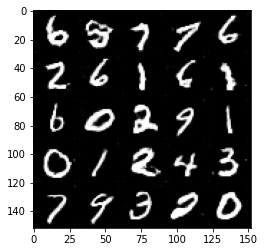

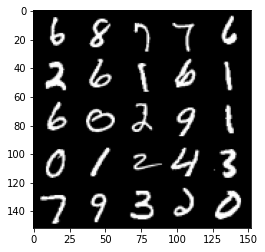

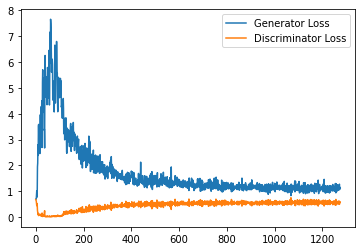

Step 26000: Generator loss: 1.1027254830598832, discriminator loss: 0.5619718984365464


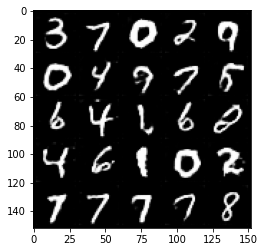

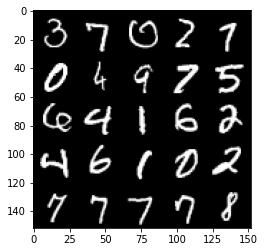

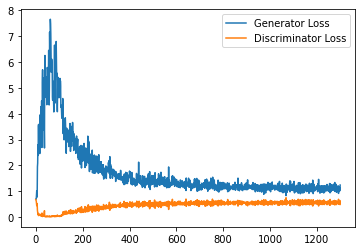

Step 26500: Generator loss: 1.124414588689804, discriminator loss: 0.5646596612334251


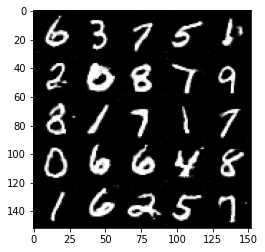

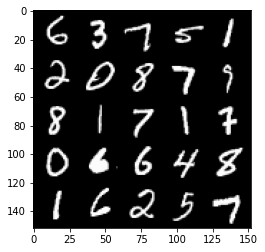

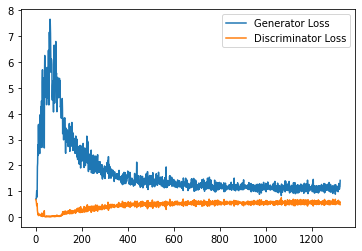

Step 27000: Generator loss: 1.0994288810491561, discriminator loss: 0.5640320646166801


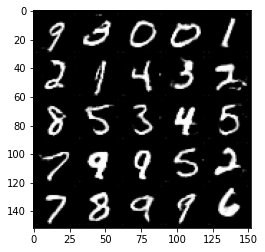

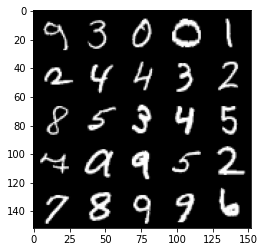

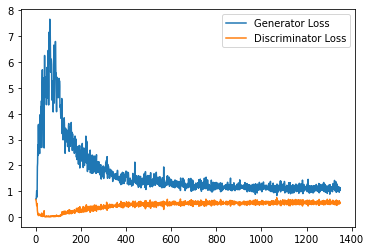

Step 27500: Generator loss: 1.0930173517465591, discriminator loss: 0.5664666638374328


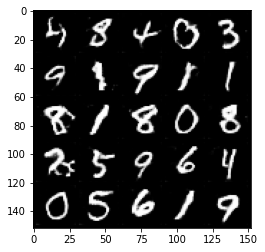

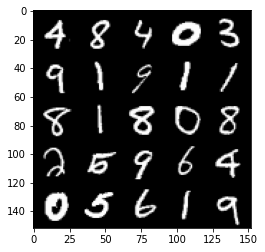

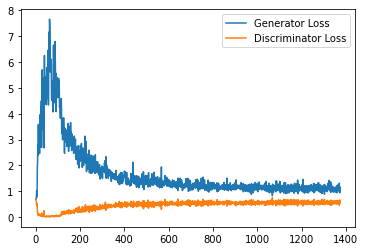

Step 28000: Generator loss: 1.1002152264118195, discriminator loss: 0.5666060400605202


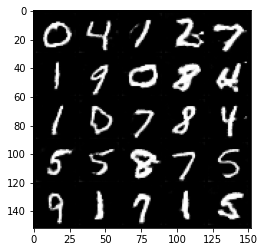

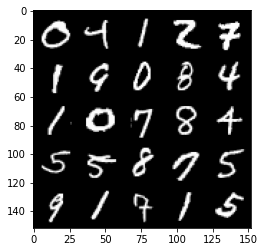

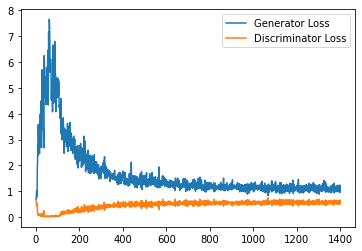

Step 28500: Generator loss: 1.1127386119365692, discriminator loss: 0.5564581309556961


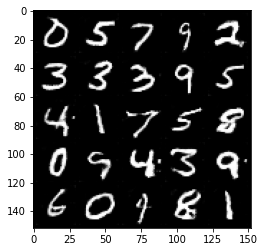

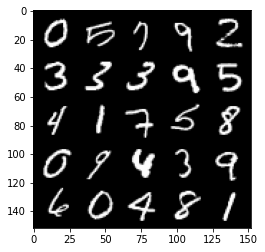

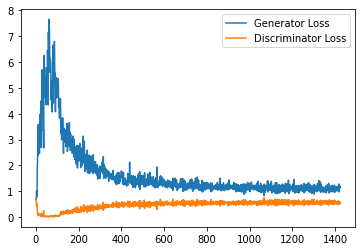

Step 29000: Generator loss: 1.0774504297971725, discriminator loss: 0.5651745691299438


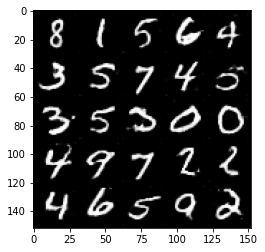

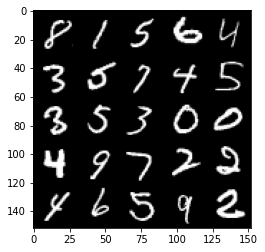

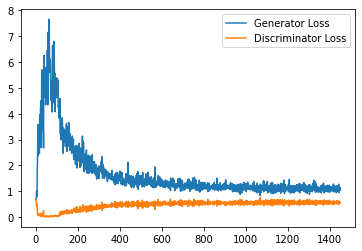

Step 29500: Generator loss: 1.0647326517105102, discriminator loss: 0.5708494720458984


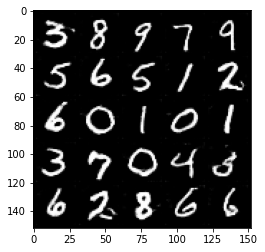

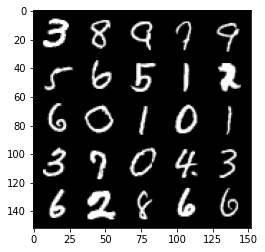

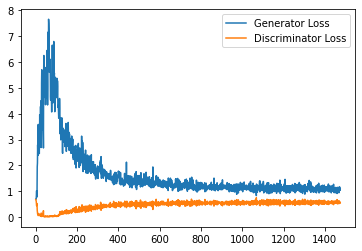

Step 30000: Generator loss: 1.0808567979335786, discriminator loss: 0.5697516011595726


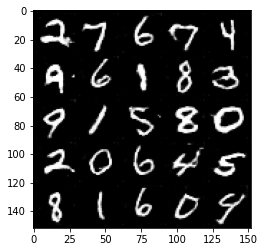

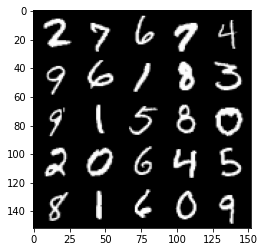

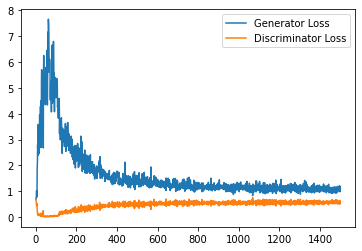

Step 30500: Generator loss: 1.0845573793649674, discriminator loss: 0.5718180671930313


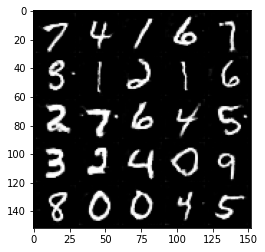

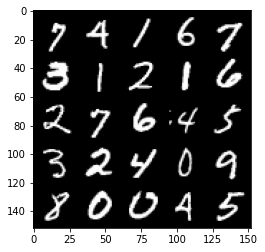

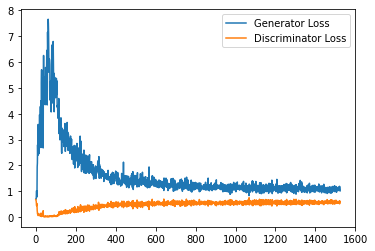

Step 31000: Generator loss: 1.0774034614562988, discriminator loss: 0.5702266630530357


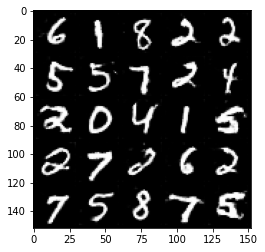

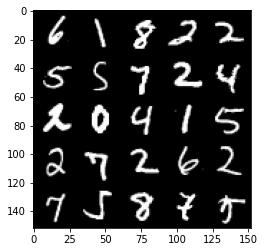

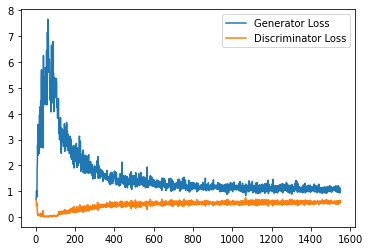

Step 31500: Generator loss: 1.0905910445451736, discriminator loss: 0.5706626055836678


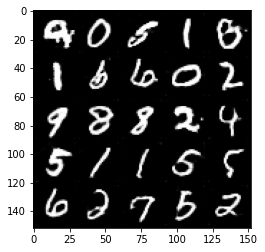

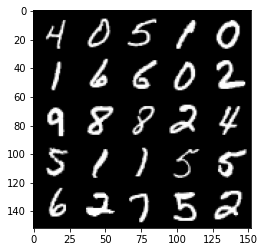

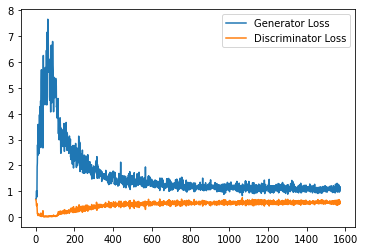

Step 32000: Generator loss: 1.0890280573368072, discriminator loss: 0.5731395415067673


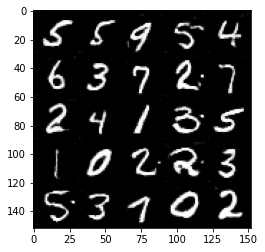

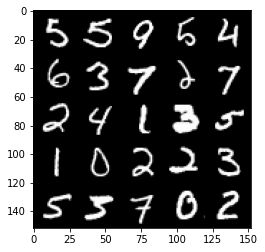

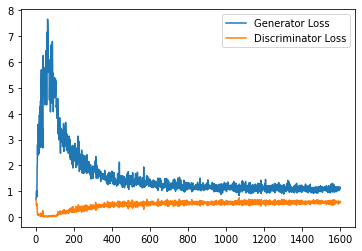

Step 32500: Generator loss: 1.0901026650667192, discriminator loss: 0.5720477999448776


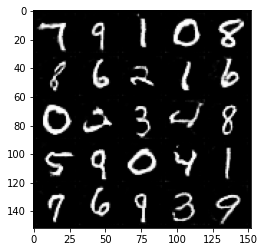

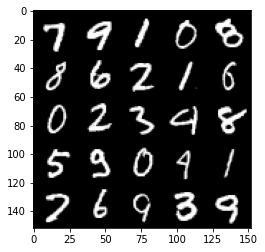

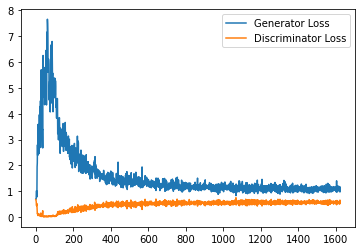

Step 33000: Generator loss: 1.066349326968193, discriminator loss: 0.575053228199482


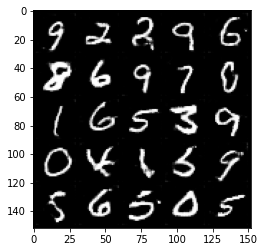

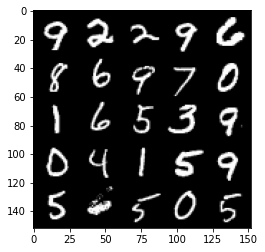

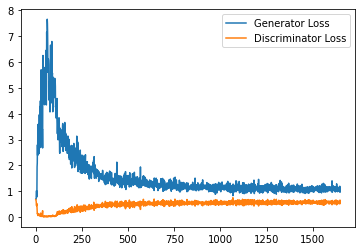

Step 33500: Generator loss: 1.0519182560443878, discriminator loss: 0.5768977591991424


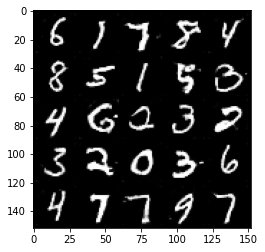

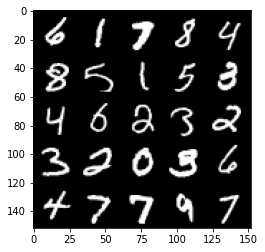

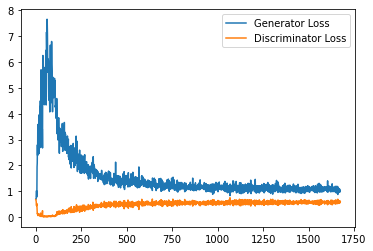

Step 34000: Generator loss: 1.069866328239441, discriminator loss: 0.5800766139030457


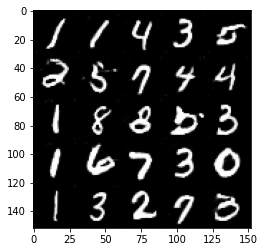

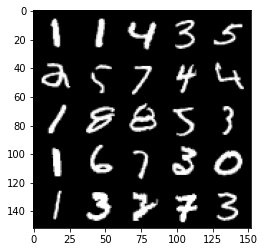

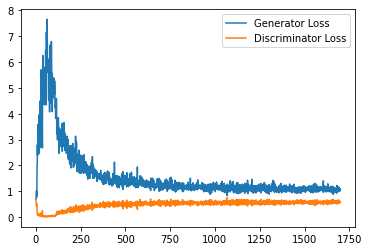

Step 34500: Generator loss: 1.0629135856628418, discriminator loss: 0.5753028235435486


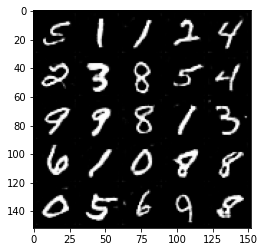

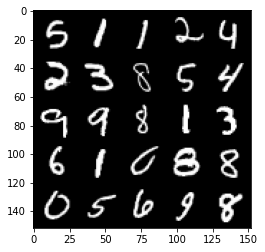

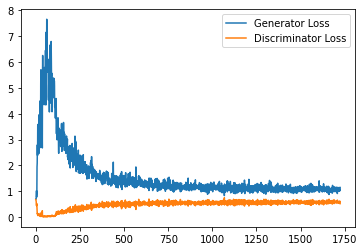

Step 35000: Generator loss: 1.065011657834053, discriminator loss: 0.5841671708226204


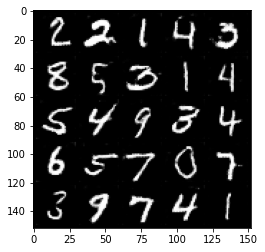

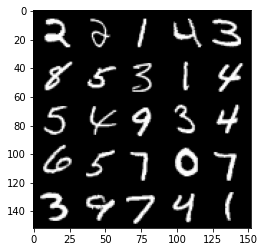

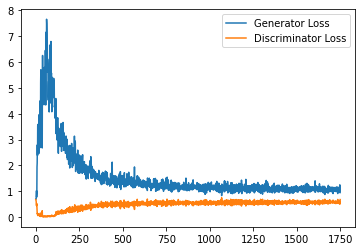

Step 35500: Generator loss: 1.0591550050973892, discriminator loss: 0.5725685216188431


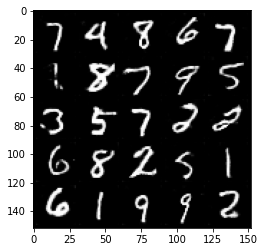

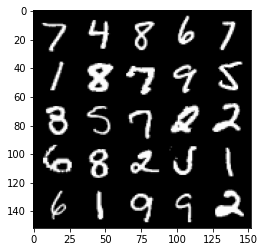

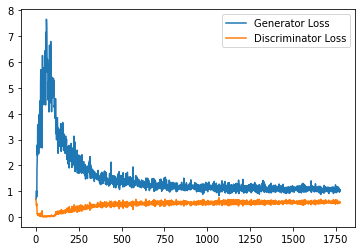

Step 36000: Generator loss: 1.0390688709020615, discriminator loss: 0.5727458827495575


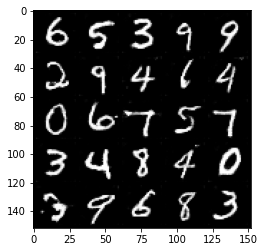

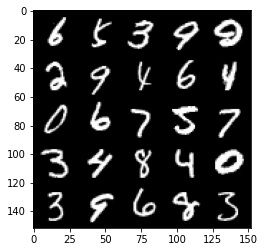

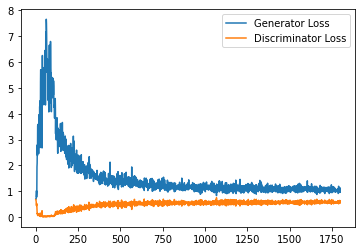

Step 36500: Generator loss: 1.0489382336139679, discriminator loss: 0.5787214117050171


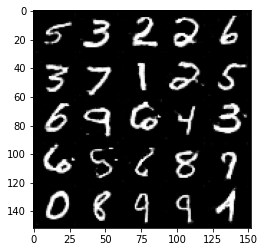

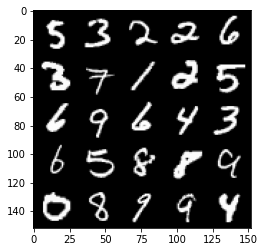

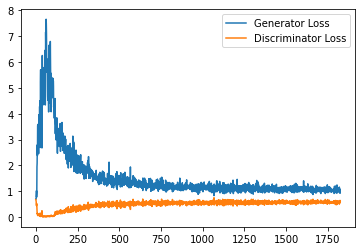

Step 37000: Generator loss: 1.0756932234764098, discriminator loss: 0.5745392777323722


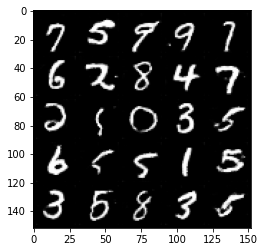

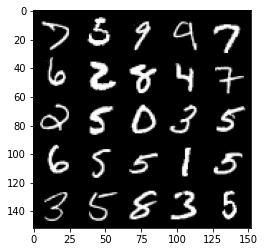

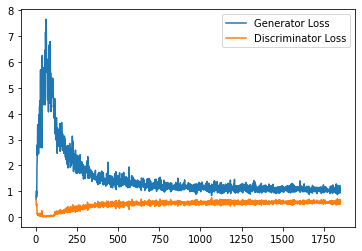

Step 37500: Generator loss: 1.0916978390216827, discriminator loss: 0.577646797478199


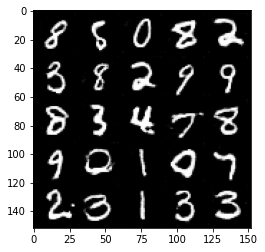

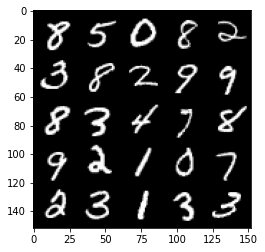

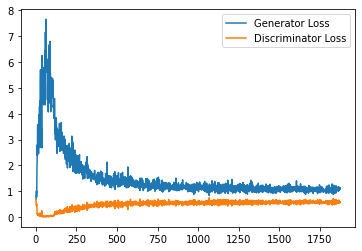

Step 38000: Generator loss: 1.060015566468239, discriminator loss: 0.5783939440846443


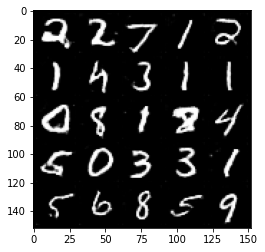

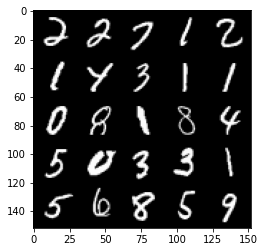

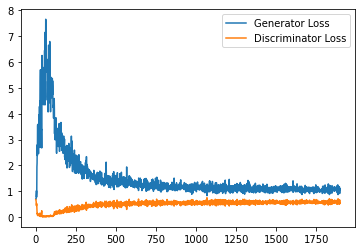

Step 38500: Generator loss: 1.0571036326885224, discriminator loss: 0.5738261853456497


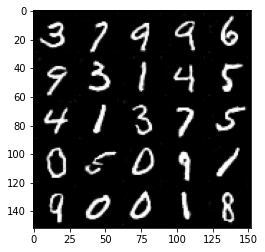

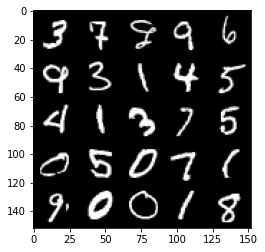

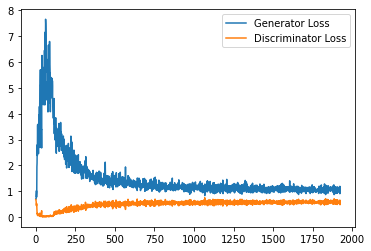

Step 39000: Generator loss: 1.0492284171581268, discriminator loss: 0.5819422954320908


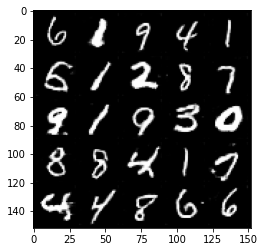

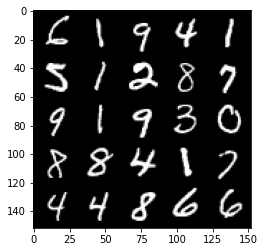

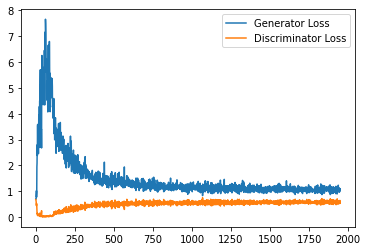

Step 39500: Generator loss: 1.04333775806427, discriminator loss: 0.5767256783246995


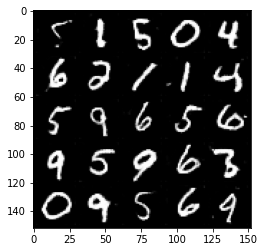

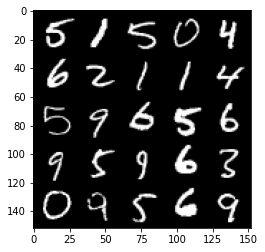

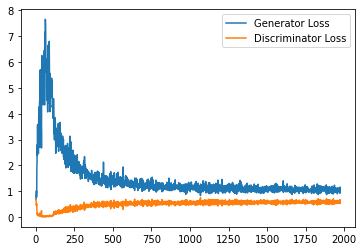

Step 40000: Generator loss: 1.073917897939682, discriminator loss: 0.5782542994618416


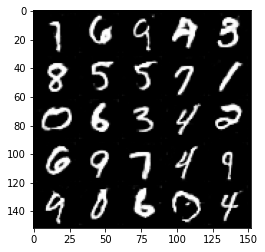

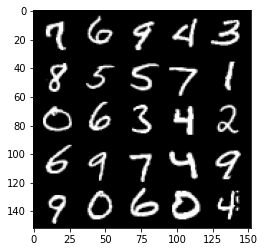

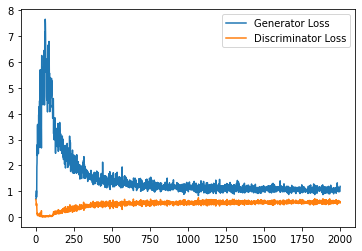

Step 40500: Generator loss: 1.0418545781373978, discriminator loss: 0.5770828840136528


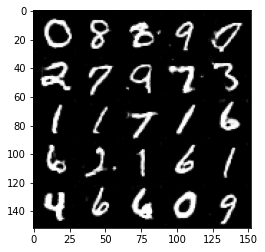

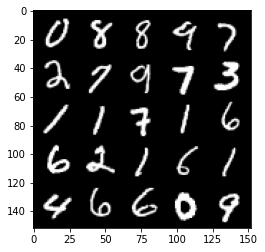

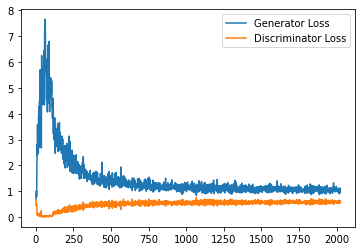

Step 41000: Generator loss: 1.0805692683458328, discriminator loss: 0.5749482854008675


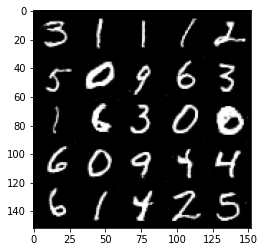

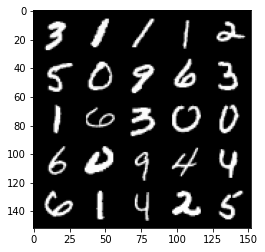

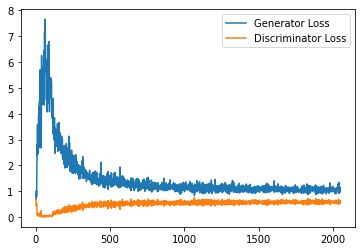

Step 41500: Generator loss: 1.0718392951488496, discriminator loss: 0.5771287722587586


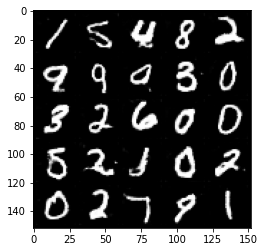

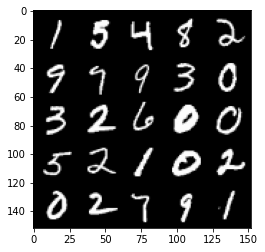

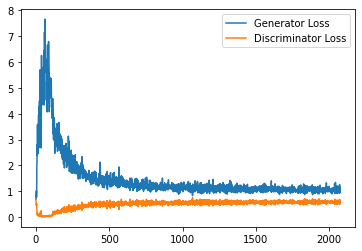

Step 42000: Generator loss: 1.069094811797142, discriminator loss: 0.5773464077711106


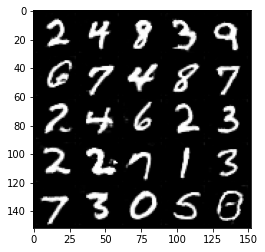

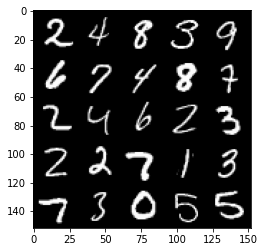

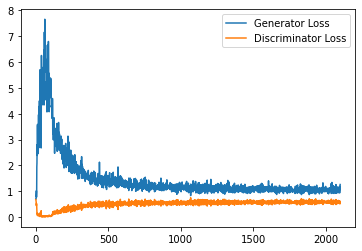

Step 42500: Generator loss: 1.0549325108528138, discriminator loss: 0.5839196456074714


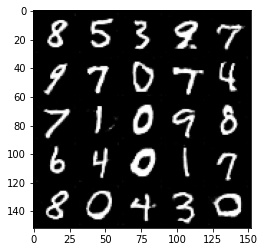

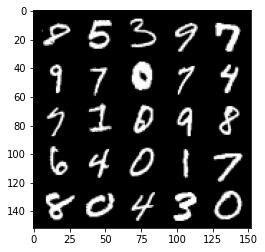

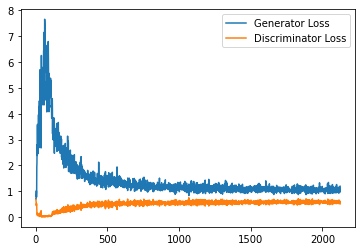

Step 43000: Generator loss: 1.0658392329216004, discriminator loss: 0.575613837659359


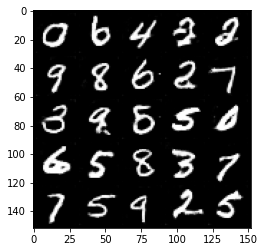

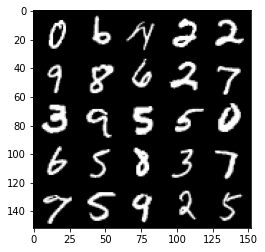

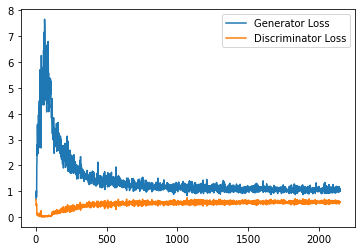

Step 43500: Generator loss: 1.0456728731393814, discriminator loss: 0.5810989691615105


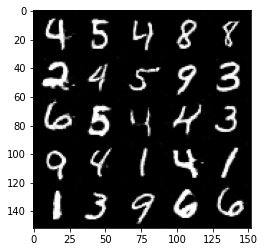

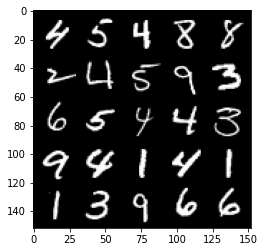

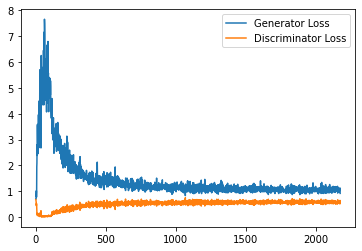

Step 44000: Generator loss: 1.0705800763368607, discriminator loss: 0.57747972625494


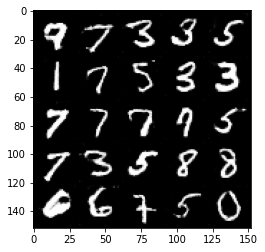

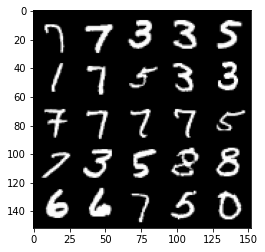

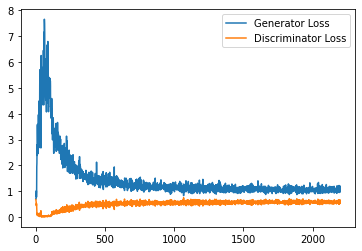

Step 44500: Generator loss: 1.0769298460483552, discriminator loss: 0.5785658720135689


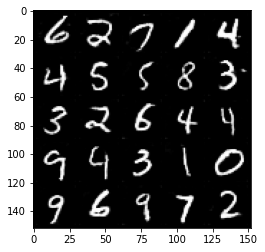

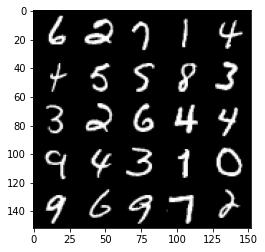

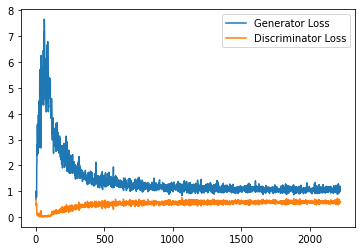

Step 45000: Generator loss: 1.061751412153244, discriminator loss: 0.5759439753890038


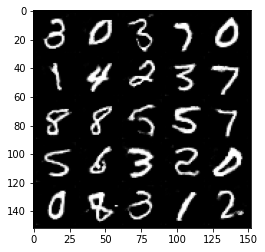

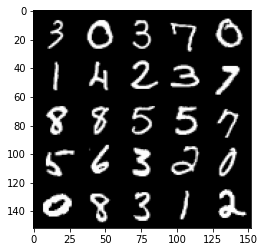

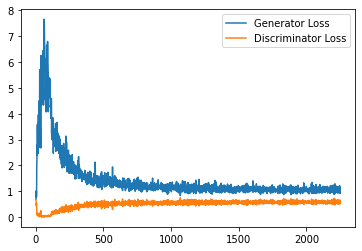

Step 45500: Generator loss: 1.066369208931923, discriminator loss: 0.57361686450243


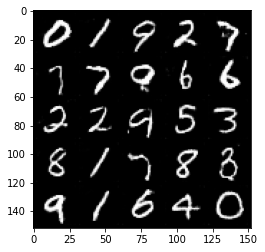

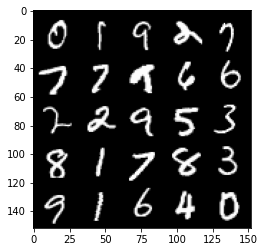

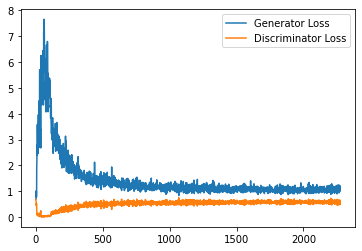

Step 46000: Generator loss: 1.042211960554123, discriminator loss: 0.5780365412831306


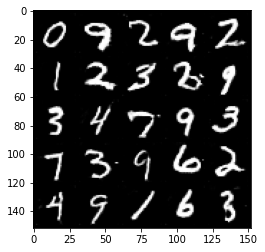

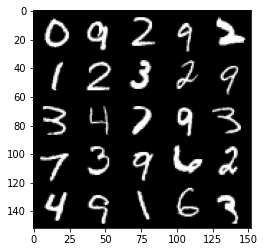

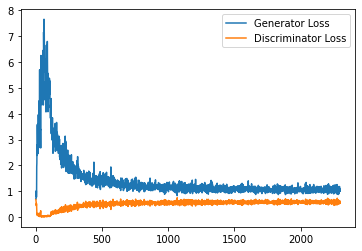

Step 46500: Generator loss: 1.063689915060997, discriminator loss: 0.5760959513783455


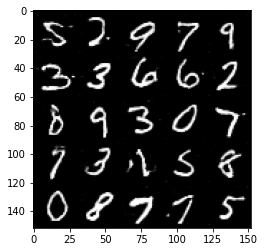

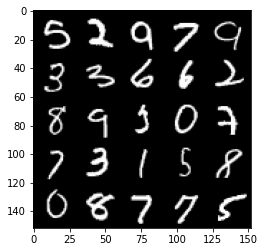

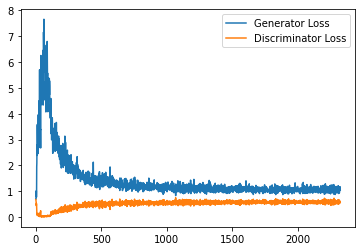

Step 47000: Generator loss: 1.058879741549492, discriminator loss: 0.5773072073459625


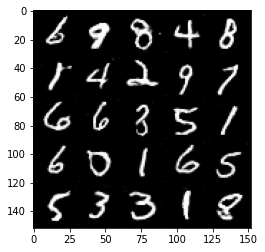

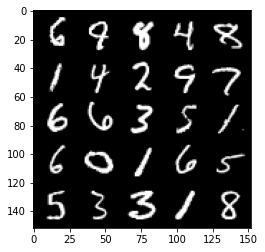

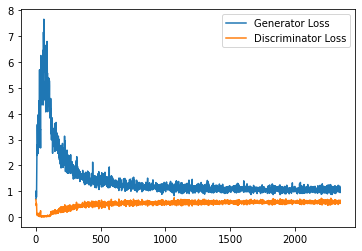

Step 47500: Generator loss: 1.0677332301139832, discriminator loss: 0.5737949778437614


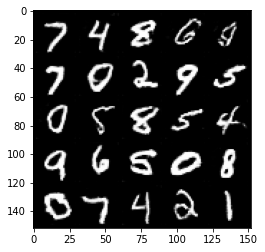

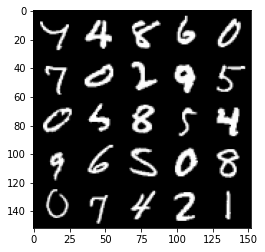

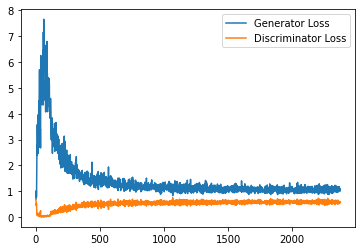

Step 48000: Generator loss: 1.0524150575399398, discriminator loss: 0.5724591895937919


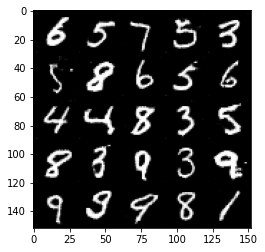

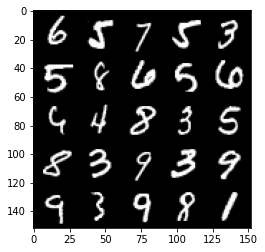

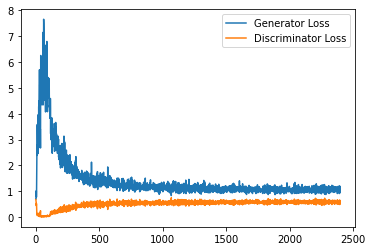

Step 48500: Generator loss: 1.0719579035043716, discriminator loss: 0.5724208753705025


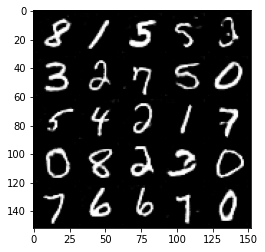

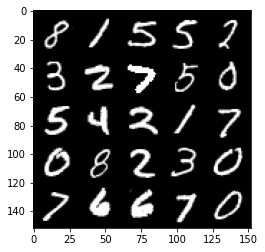

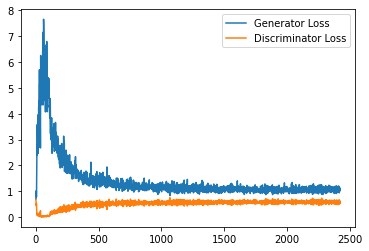

Step 49000: Generator loss: 1.0510156981945038, discriminator loss: 0.5713853845596314


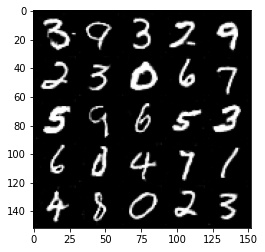

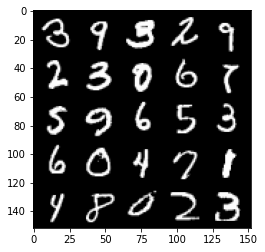

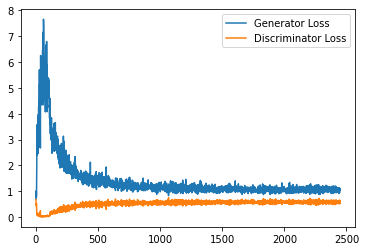

Step 49500: Generator loss: 1.050284187078476, discriminator loss: 0.5756569294929504


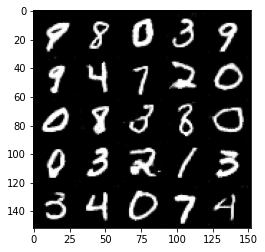

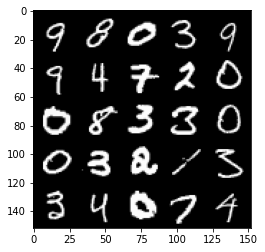

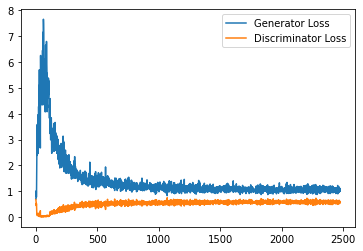

Step 50000: Generator loss: 1.0747377655506134, discriminator loss: 0.5758685163855553


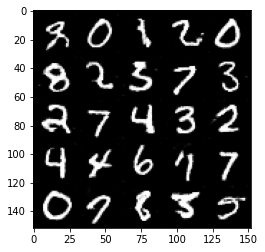

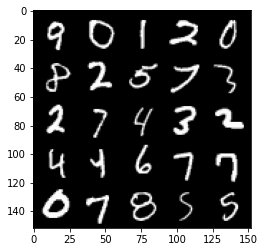

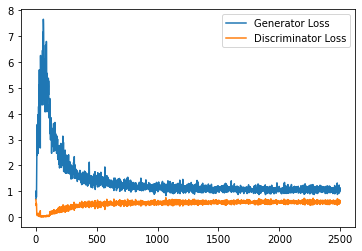

Step 50500: Generator loss: 1.0601520915031433, discriminator loss: 0.5775414034724236


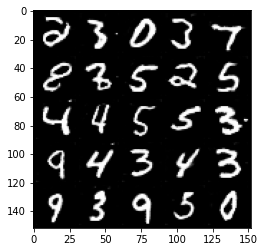

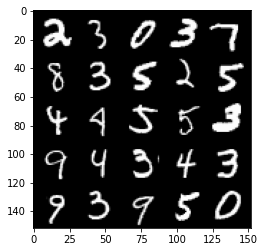

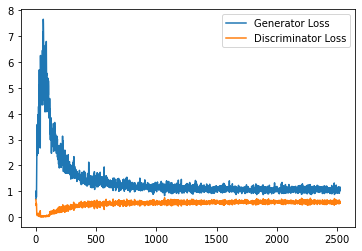

Step 51000: Generator loss: 1.0544991022348404, discriminator loss: 0.5710592865943909


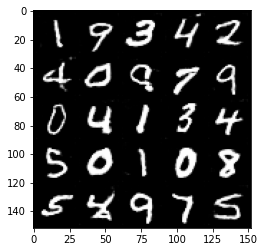

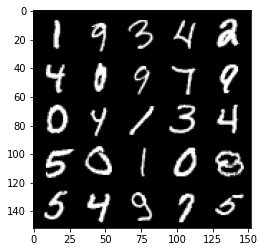

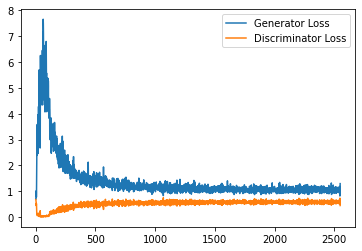

Step 51500: Generator loss: 1.0650098185539245, discriminator loss: 0.5801139386892319


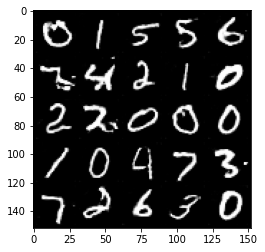

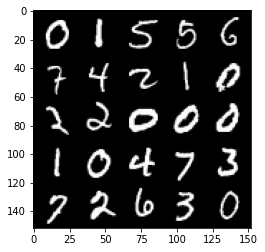

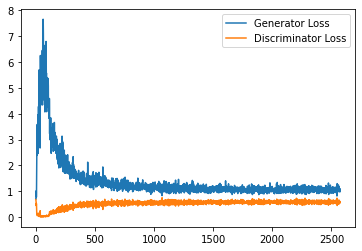

Step 52000: Generator loss: 1.073545900464058, discriminator loss: 0.5672530477046966


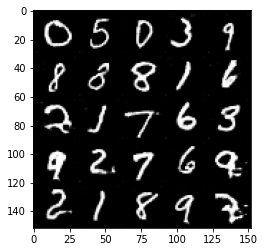

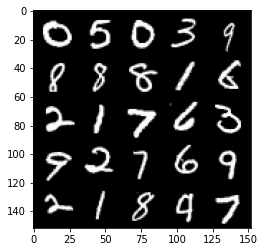

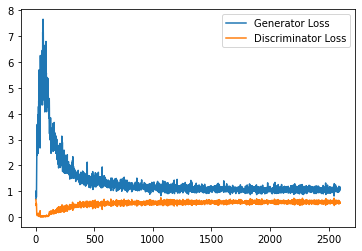

Step 52500: Generator loss: 1.0808782292604446, discriminator loss: 0.5720814108252525


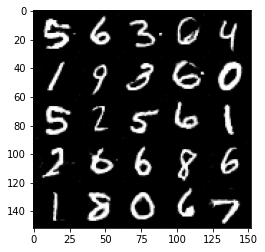

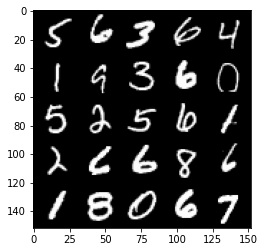

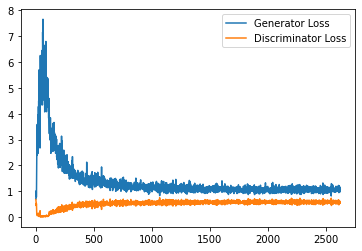

Step 53000: Generator loss: 1.0708286473751067, discriminator loss: 0.5751590490341186


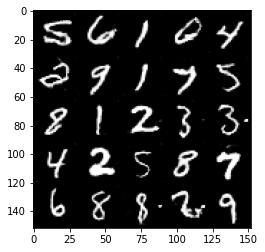

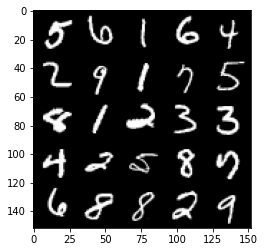

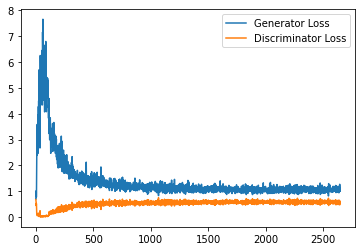

Step 53500: Generator loss: 1.0483418697118758, discriminator loss: 0.5725502819418907


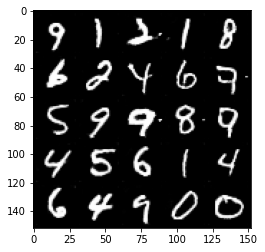

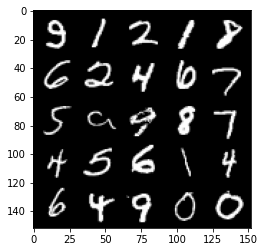

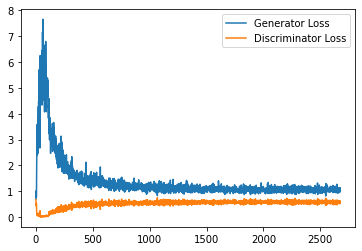

Step 54000: Generator loss: 1.0576803258657455, discriminator loss: 0.5776604114770889


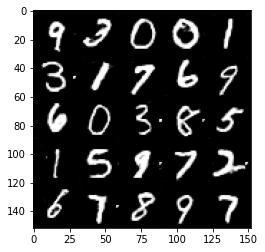

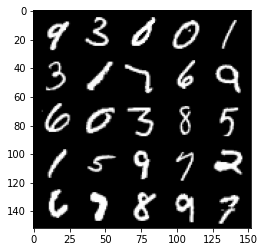

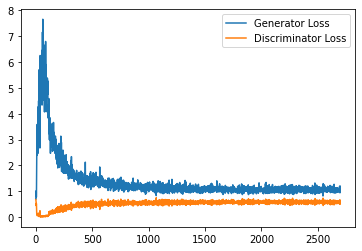

Step 54500: Generator loss: 1.061450122833252, discriminator loss: 0.5774335205554962


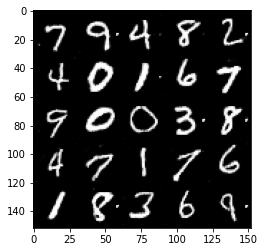

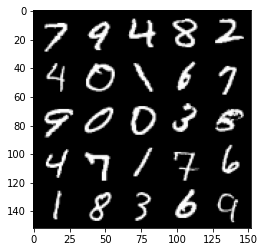

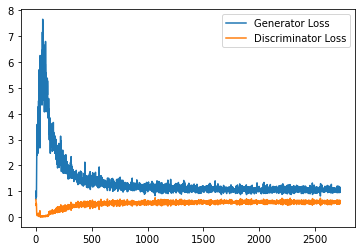

Step 55000: Generator loss: 1.0679649617671967, discriminator loss: 0.5747118049263954


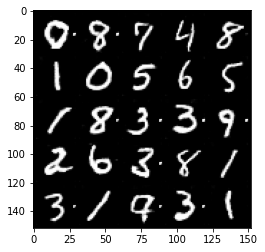

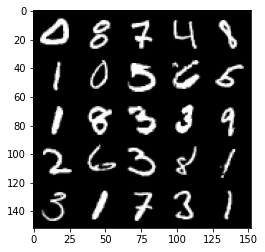

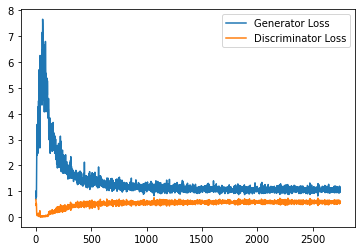

Step 55500: Generator loss: 1.0617241986989976, discriminator loss: 0.5763319711685181


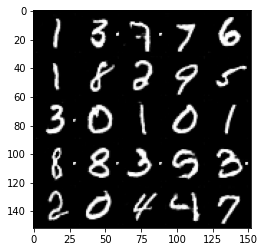

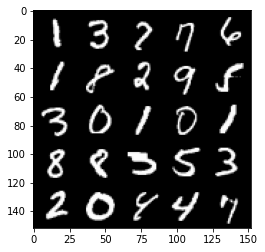

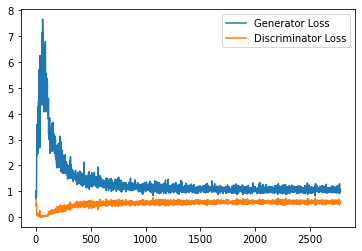

Step 56000: Generator loss: 1.052575027346611, discriminator loss: 0.5730625619292259


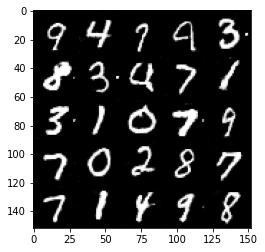

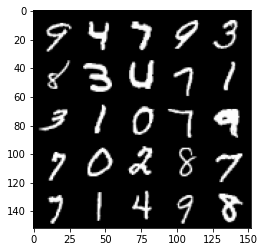

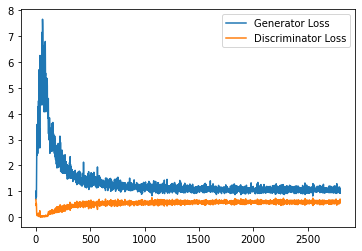

Step 56500: Generator loss: 1.0954201877117158, discriminator loss: 0.5645046126842499


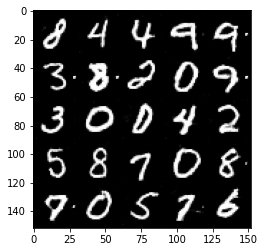

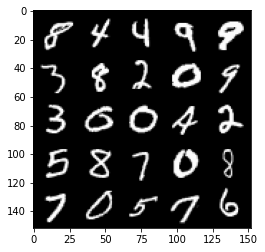

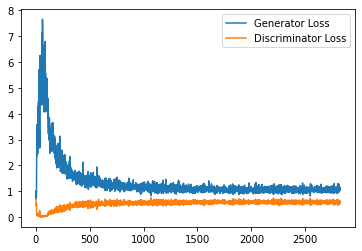

Step 57000: Generator loss: 1.0759751502275468, discriminator loss: 0.5706452457308769


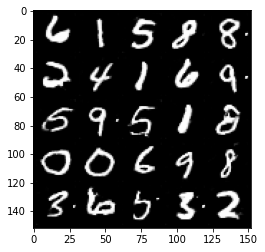

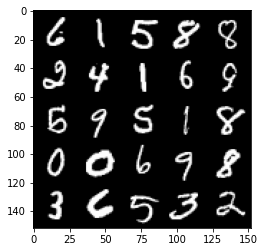

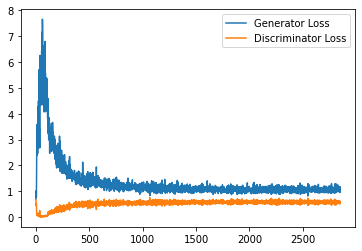

Step 57500: Generator loss: 1.0677518981695175, discriminator loss: 0.5737953278422355


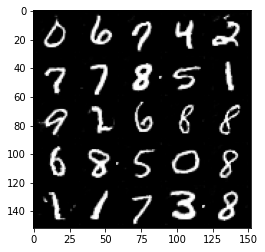

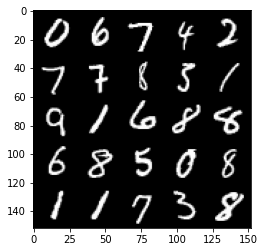

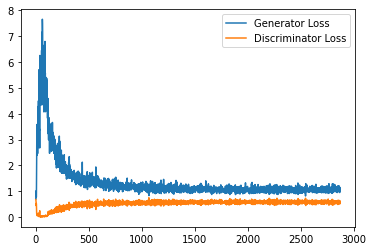

Step 58000: Generator loss: 1.0749339286088944, discriminator loss: 0.5700308519601822


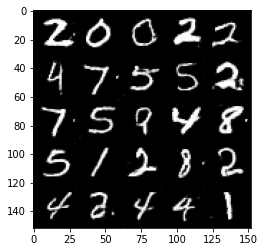

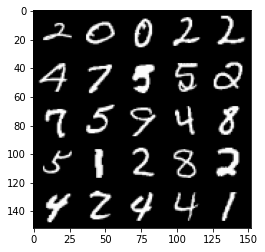

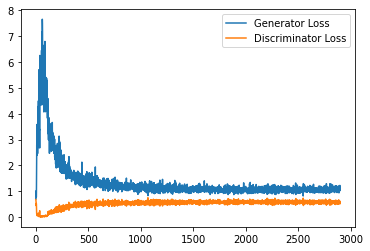

Step 58500: Generator loss: 1.0771466919183732, discriminator loss: 0.5691327319145203


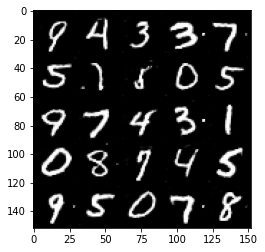

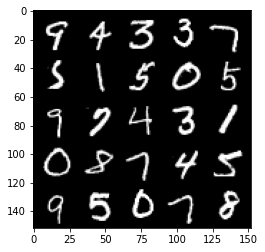

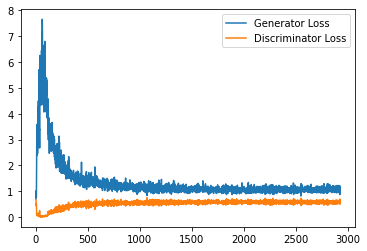

Step 59000: Generator loss: 1.0892558156251908, discriminator loss: 0.5783687818646431


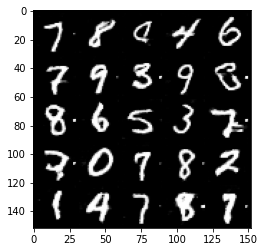

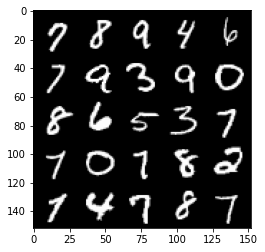

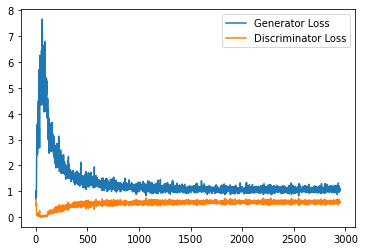

Step 59500: Generator loss: 1.0854161133766174, discriminator loss: 0.569010467350483


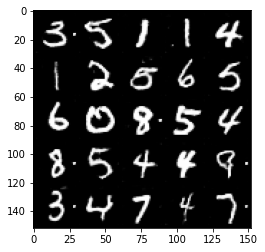

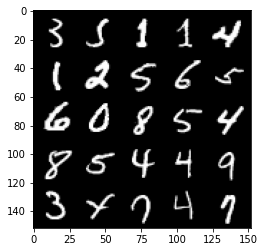

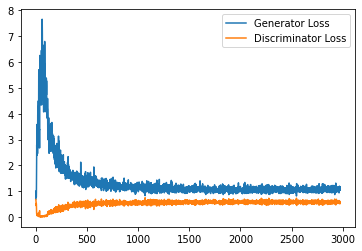

Step 60000: Generator loss: 1.0727337387800218, discriminator loss: 0.5729820681214333


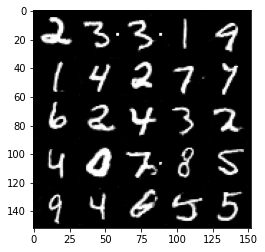

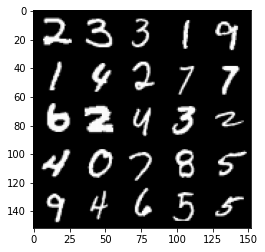

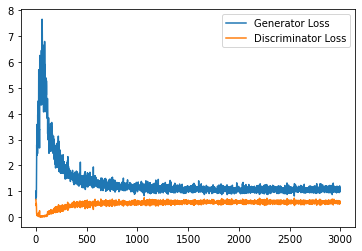

Step 60500: Generator loss: 1.0879961053133012, discriminator loss: 0.575383791923523


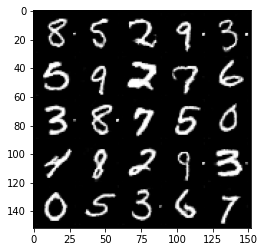

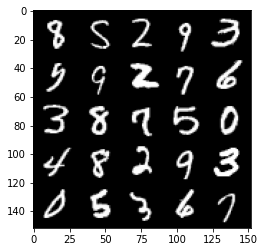

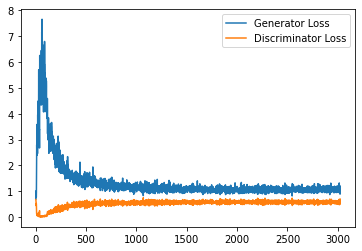

Step 61000: Generator loss: 1.0730040670633316, discriminator loss: 0.5684389935731888


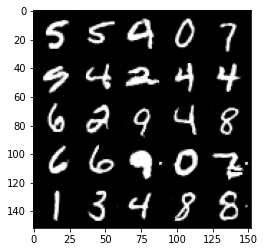

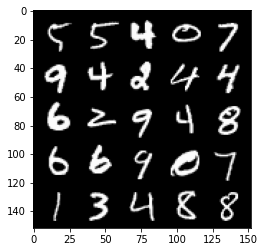

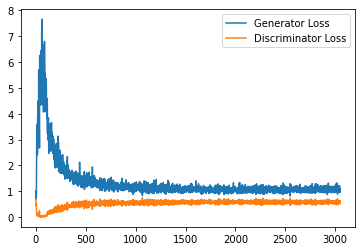

Step 61500: Generator loss: 1.0636634929180144, discriminator loss: 0.5723719944953919


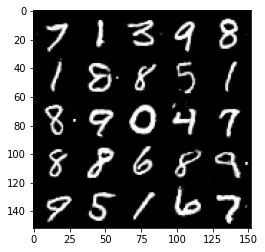

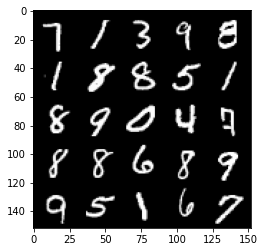

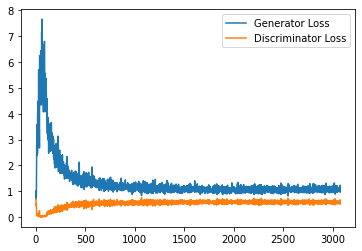

Step 62000: Generator loss: 1.0834041177034377, discriminator loss: 0.5751654432415962


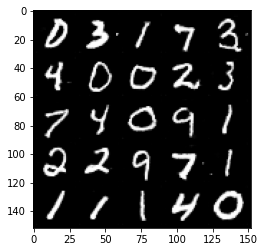

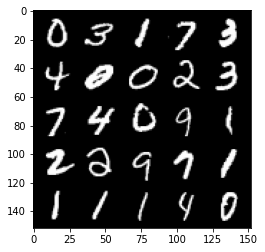

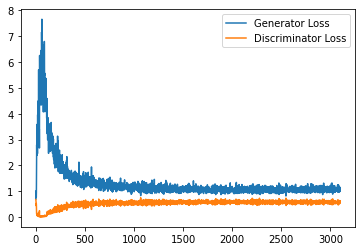

Step 62500: Generator loss: 1.0796581745147704, discriminator loss: 0.5704026625156403


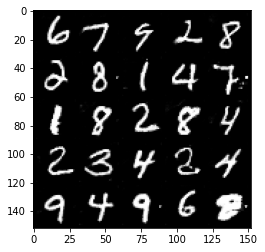

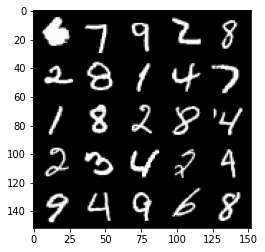

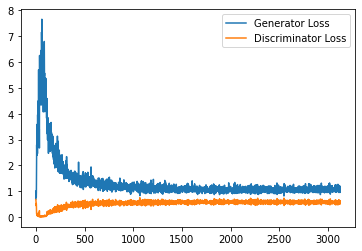

Step 63000: Generator loss: 1.0780409004688263, discriminator loss: 0.5665748697519303


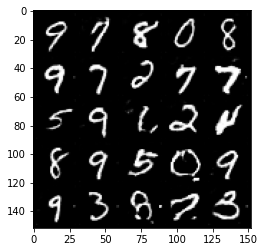

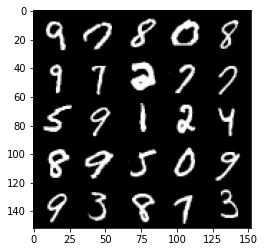

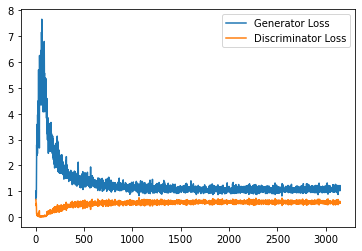

Step 63500: Generator loss: 1.083635708808899, discriminator loss: 0.5740122609138488


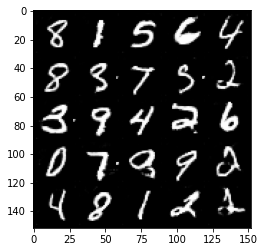

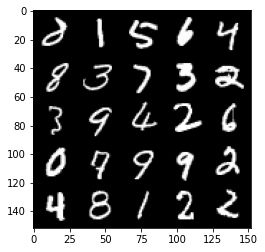

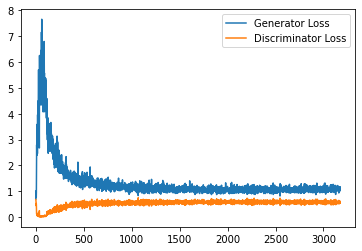

Step 64000: Generator loss: 1.0753815544843675, discriminator loss: 0.5733015807271004


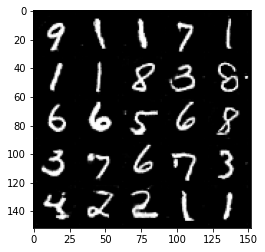

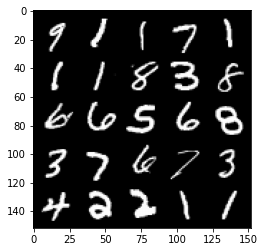

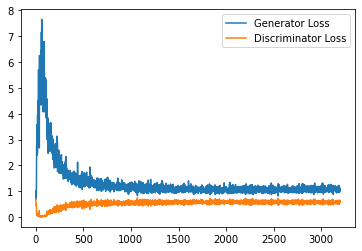

Step 64500: Generator loss: 1.0649196215867995, discriminator loss: 0.5728194496631622


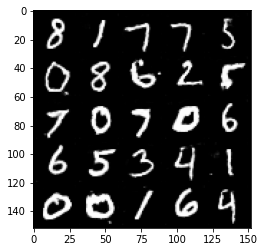

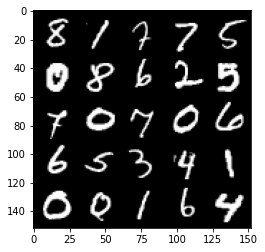

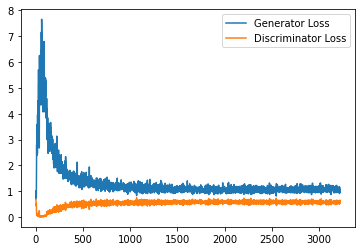

Step 65000: Generator loss: 1.0772115569114684, discriminator loss: 0.5712060494422913


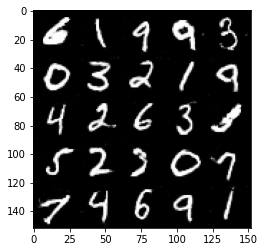

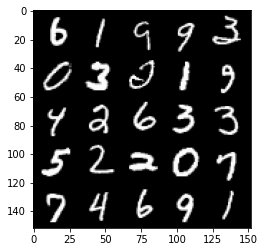

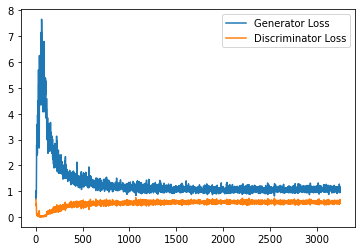

Step 65500: Generator loss: 1.083786228775978, discriminator loss: 0.5729893559813499


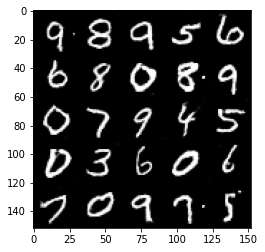

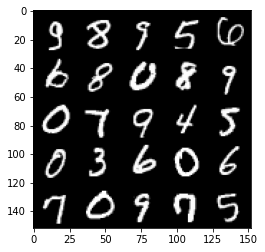

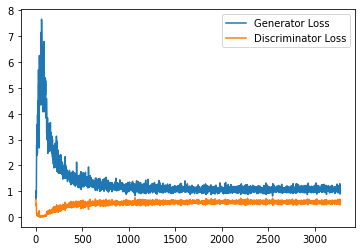

Step 66000: Generator loss: 1.0732721552848816, discriminator loss: 0.5696412748694419


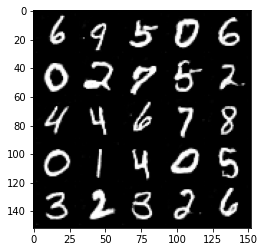

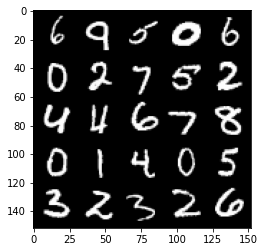

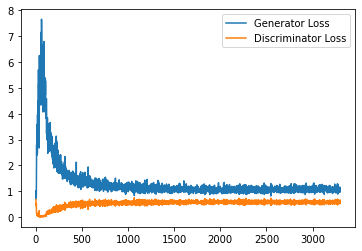

Step 66500: Generator loss: 1.0987807133197784, discriminator loss: 0.5699309173226357


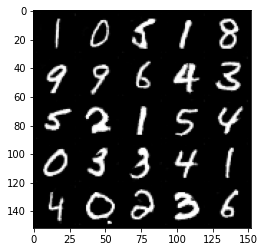

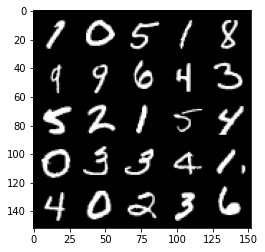

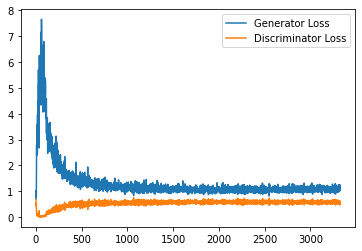

Step 67000: Generator loss: 1.0725050933361053, discriminator loss: 0.5707009596228599


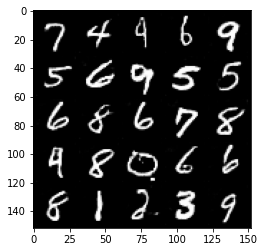

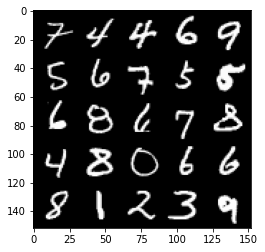

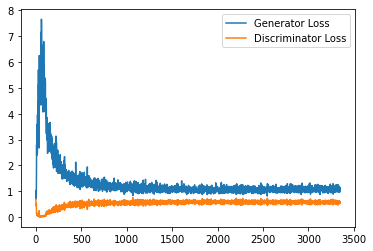

Step 67500: Generator loss: 1.0730478497743607, discriminator loss: 0.5748698684573174


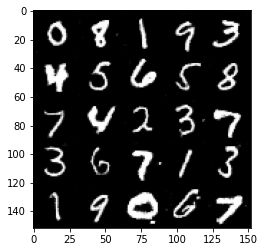

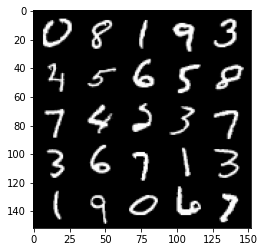

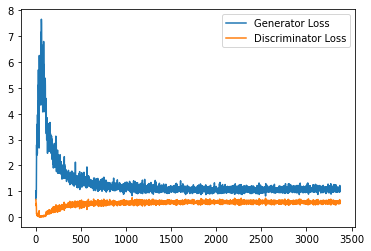

Step 68000: Generator loss: 1.1051196154356002, discriminator loss: 0.5677886699438095


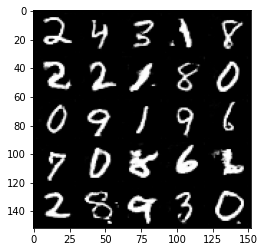

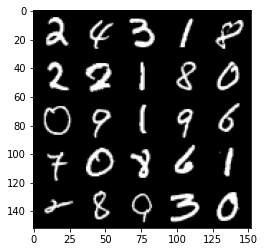

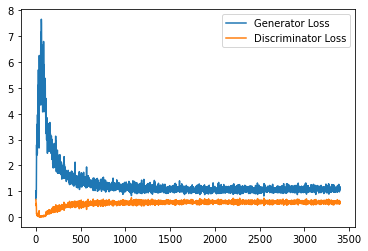

Step 68500: Generator loss: 1.0841483824253082, discriminator loss: 0.5730721962451935


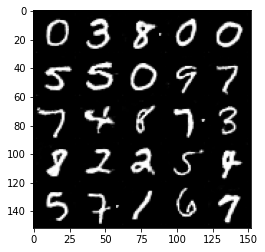

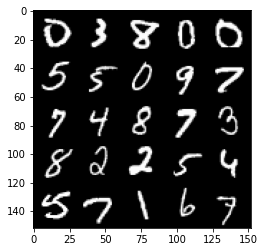

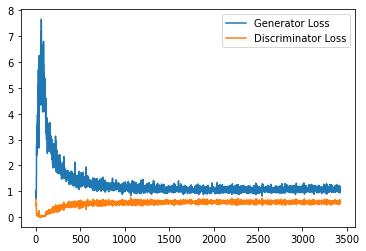

Step 69000: Generator loss: 1.087221921145916, discriminator loss: 0.5709458931088448


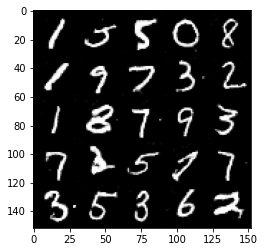

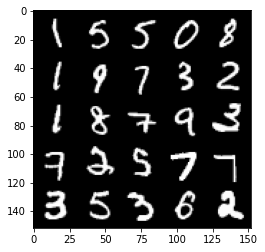

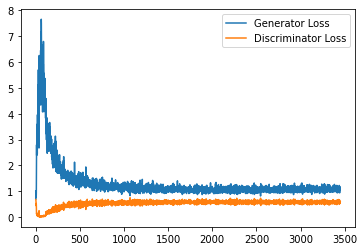

Step 69500: Generator loss: 1.0756923314332962, discriminator loss: 0.5688435324430465


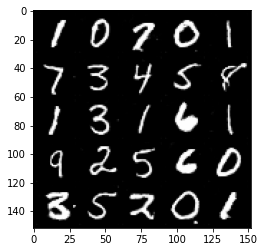

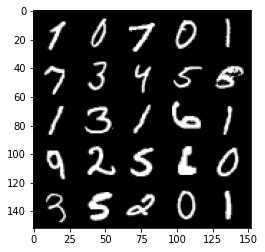

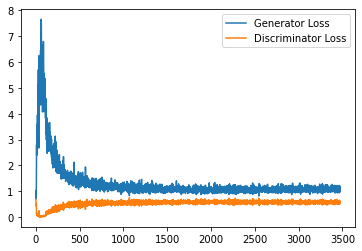

Step 70000: Generator loss: 1.0620908563137055, discriminator loss: 0.5711398203969001


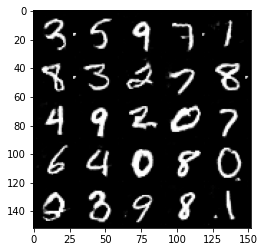

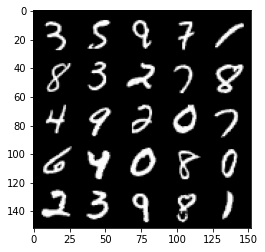

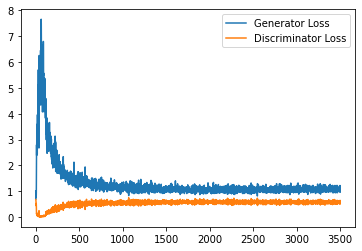

Step 70500: Generator loss: 1.107621200323105, discriminator loss: 0.5657835206389428


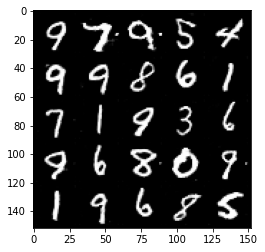

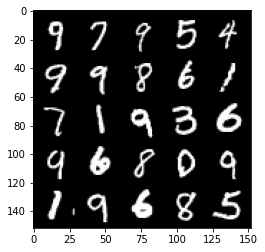

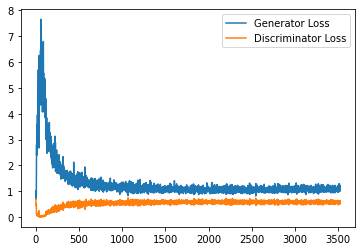

Step 71000: Generator loss: 1.0814704234600068, discriminator loss: 0.5667610050439834


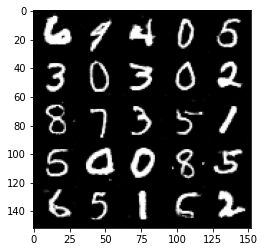

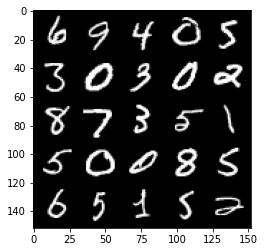

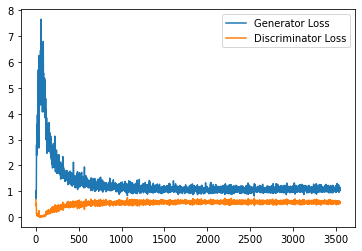

Step 71500: Generator loss: 1.091416607260704, discriminator loss: 0.5667299900054932


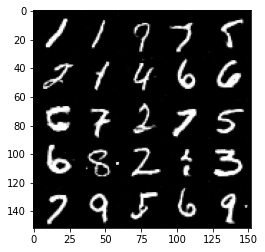

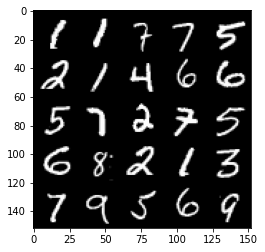

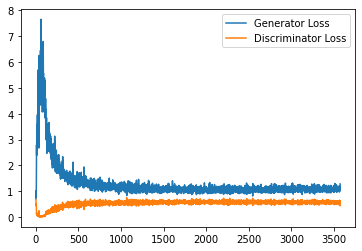

Step 72000: Generator loss: 1.0851540361642837, discriminator loss: 0.5747044851779938


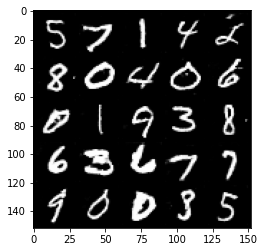

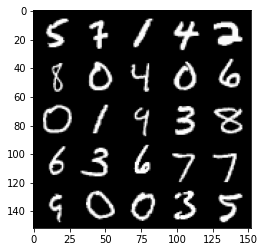

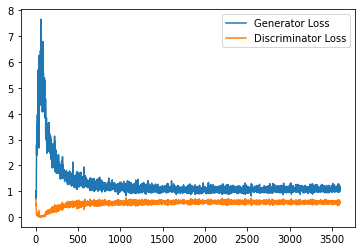

Step 72500: Generator loss: 1.086637554526329, discriminator loss: 0.5690084865093231


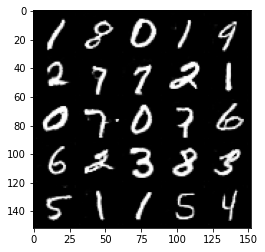

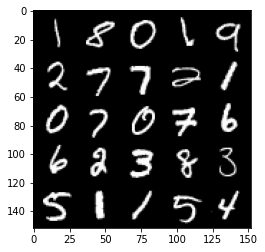

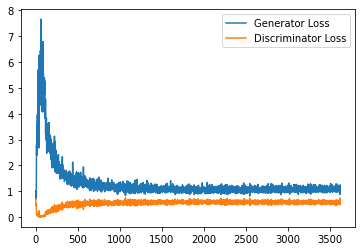

Step 73000: Generator loss: 1.0791567027568818, discriminator loss: 0.5660012854337693


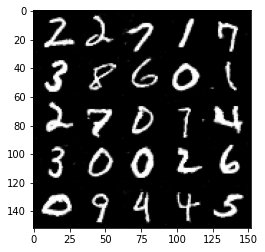

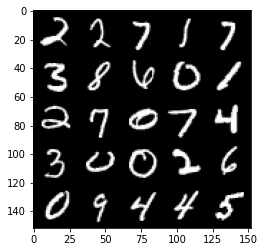

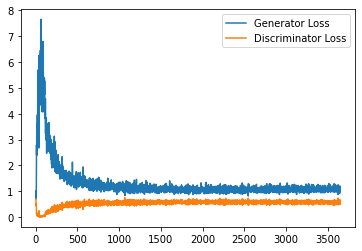

Step 73500: Generator loss: 1.1089578453302384, discriminator loss: 0.5625050570964814


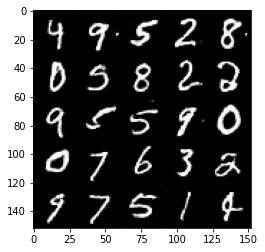

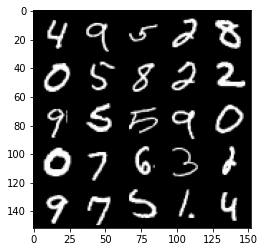

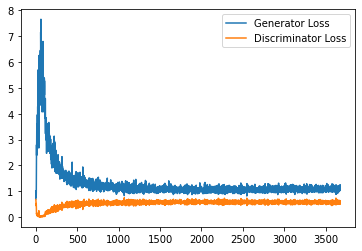

Step 74000: Generator loss: 1.0994148774147035, discriminator loss: 0.5708679152727127


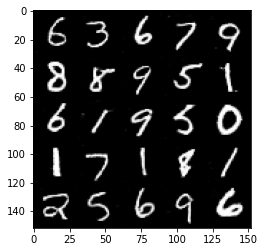

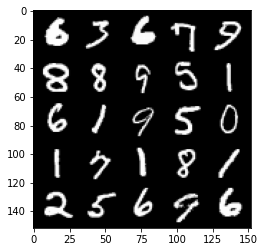

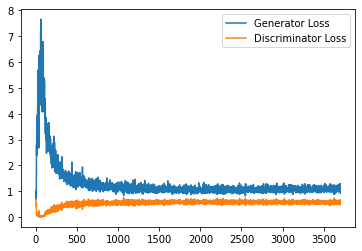

Step 74500: Generator loss: 1.0863794996738434, discriminator loss: 0.5716745629906654


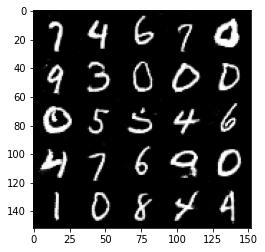

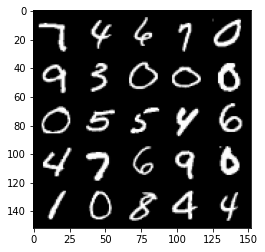

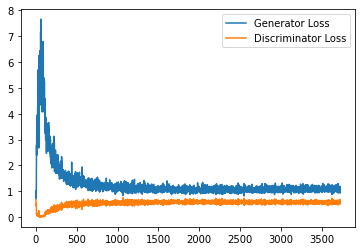

Step 75000: Generator loss: 1.090559242248535, discriminator loss: 0.5617475143671036


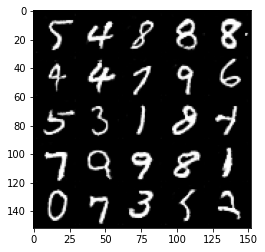

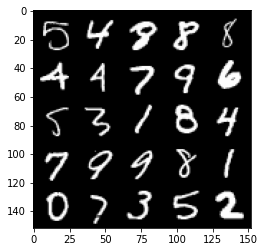

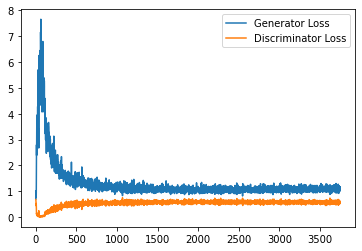

Step 75500: Generator loss: 1.0982236362695694, discriminator loss: 0.5673376246094703


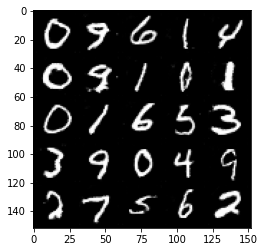

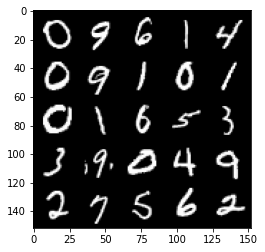

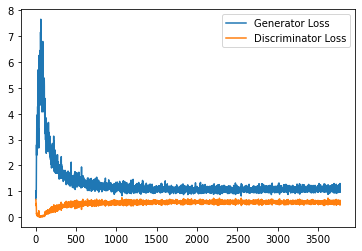

Step 76000: Generator loss: 1.0999532766342164, discriminator loss: 0.5604706379771233


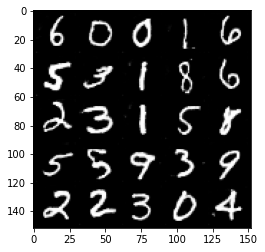

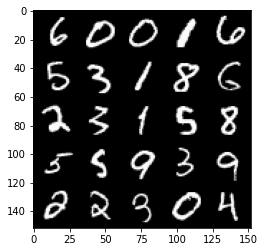

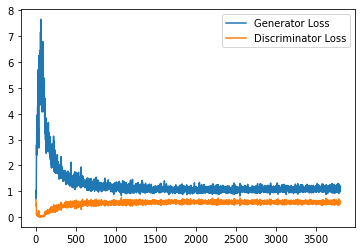

Step 76500: Generator loss: 1.114110141992569, discriminator loss: 0.5625917437672615


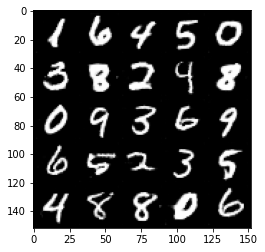

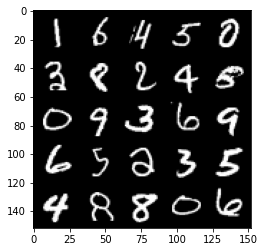

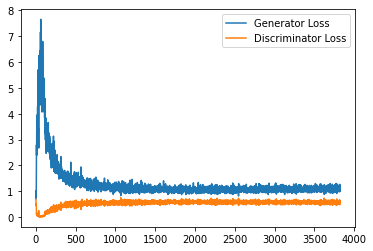

Step 77000: Generator loss: 1.1126465587615966, discriminator loss: 0.5635333200097083


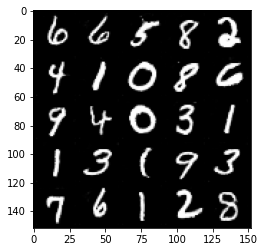

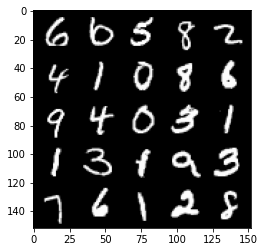

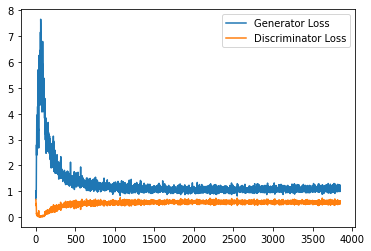

Step 77500: Generator loss: 1.0995048154592515, discriminator loss: 0.5638159762024879


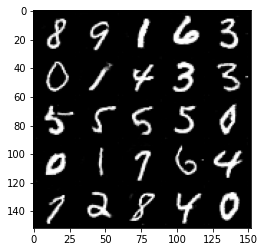

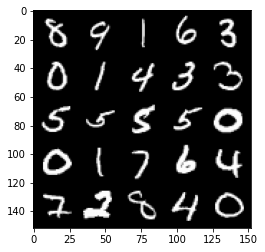

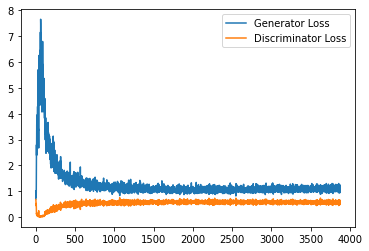

Step 78000: Generator loss: 1.1194635808467865, discriminator loss: 0.5632424960136414


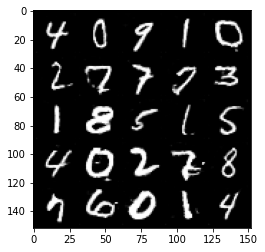

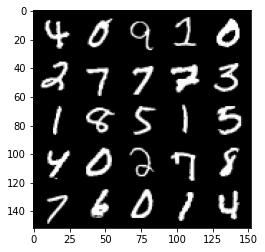

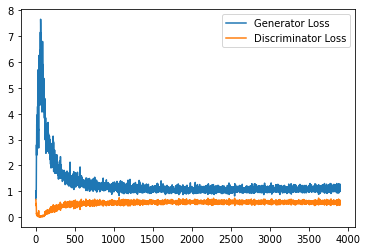

Step 78500: Generator loss: 1.1078816519975663, discriminator loss: 0.5674045367240905


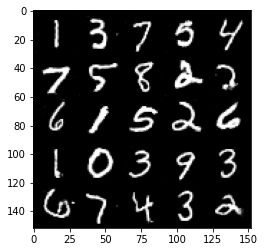

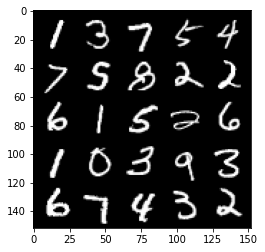

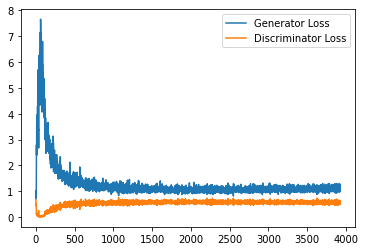

Step 79000: Generator loss: 1.1203492580652237, discriminator loss: 0.5630232418179512


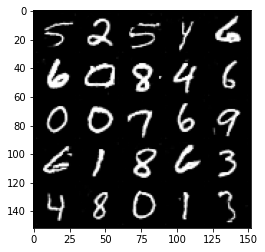

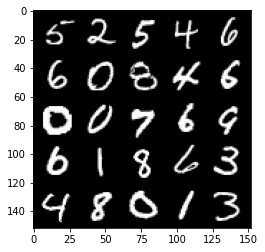

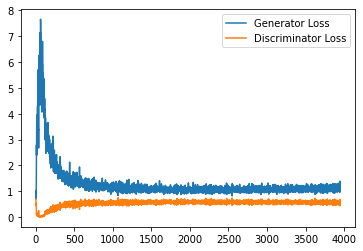

Step 79500: Generator loss: 1.1122752069234847, discriminator loss: 0.560649073779583


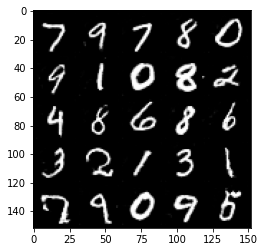

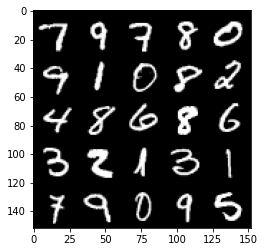

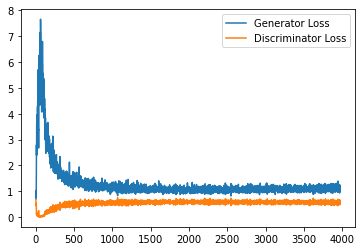

Step 80000: Generator loss: 1.091501653432846, discriminator loss: 0.5625170458555222


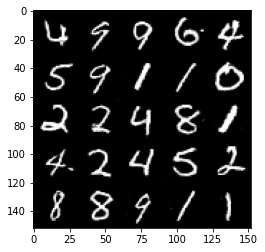

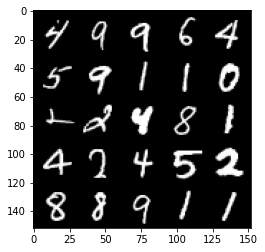

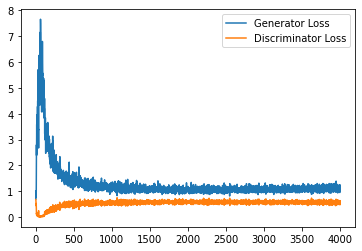

Step 80500: Generator loss: 1.1110234977006912, discriminator loss: 0.5670597028136254


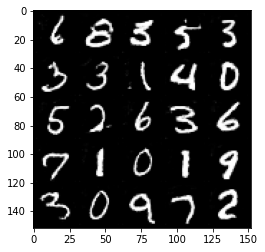

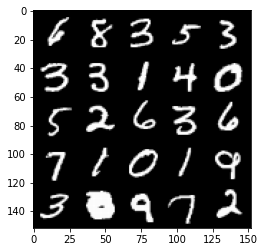

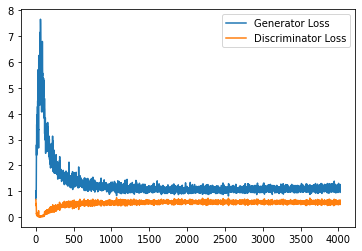

Step 81000: Generator loss: 1.1125782483816147, discriminator loss: 0.5597325101494789


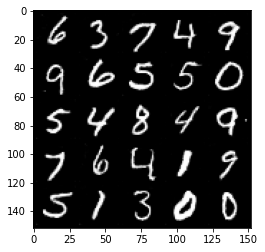

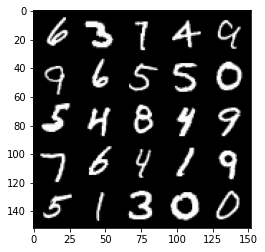

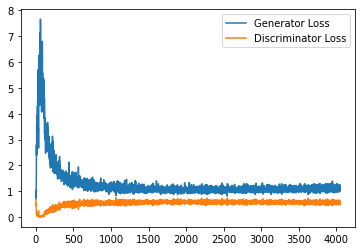

Step 81500: Generator loss: 1.1088083448410033, discriminator loss: 0.5650285758376121


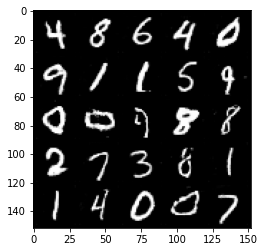

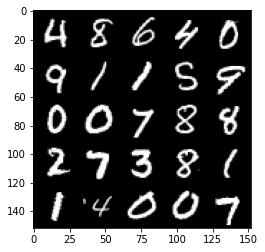

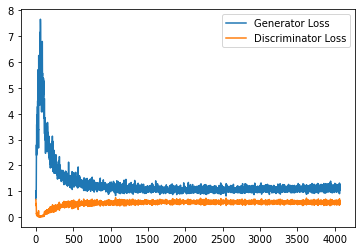

Step 82000: Generator loss: 1.1096395341157914, discriminator loss: 0.5613187367916107


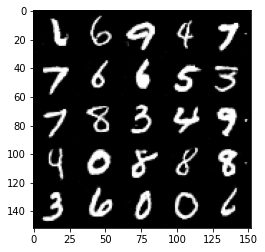

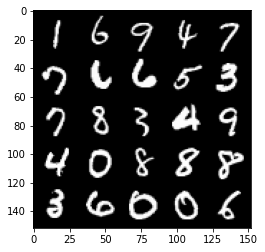

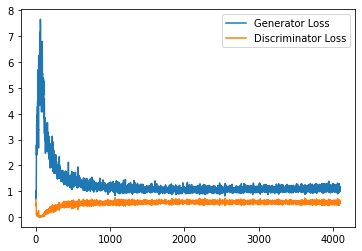

Step 82500: Generator loss: 1.1166125330924987, discriminator loss: 0.5614899705052376


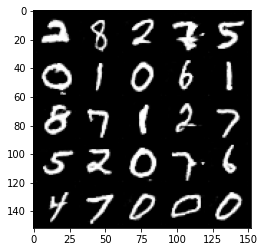

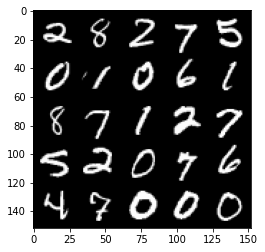

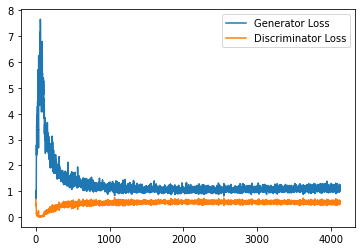

Step 83000: Generator loss: 1.1270059250593185, discriminator loss: 0.5660709040164947


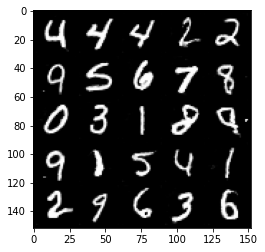

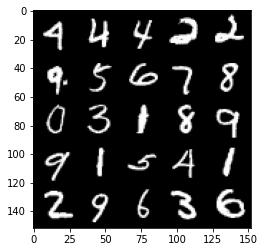

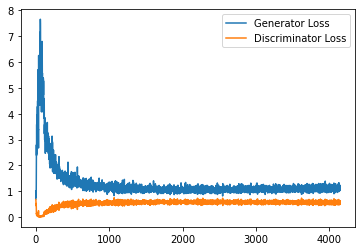

Step 83500: Generator loss: 1.093826512694359, discriminator loss: 0.5620291981101037


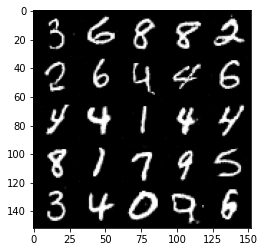

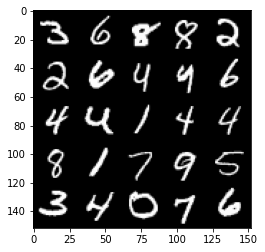

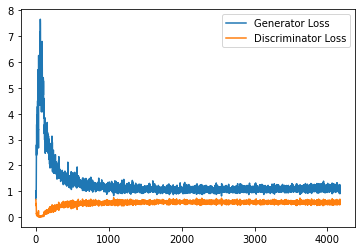

Step 84000: Generator loss: 1.1121973974704742, discriminator loss: 0.5609191216826439


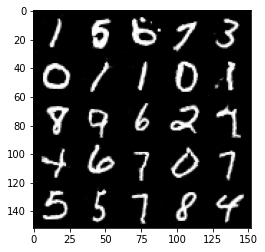

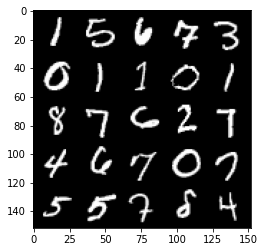

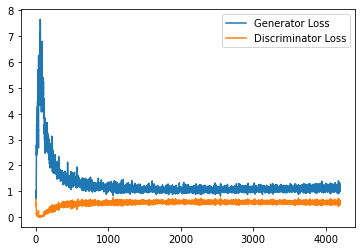

Step 84500: Generator loss: 1.100512416958809, discriminator loss: 0.5574803496599198


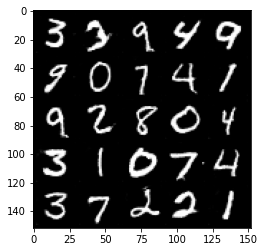

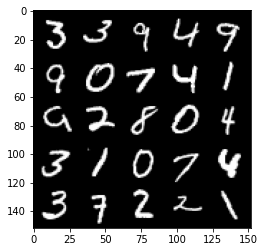

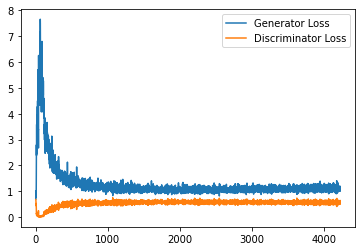

Step 85000: Generator loss: 1.1129437707662582, discriminator loss: 0.5563560930490494


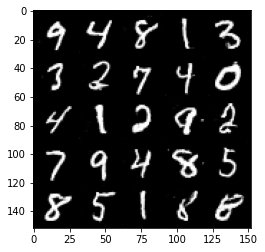

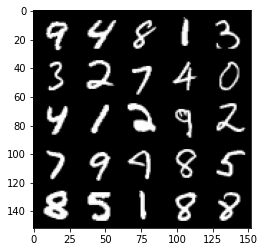

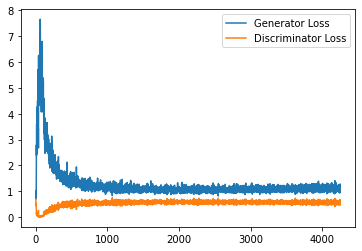

Step 85500: Generator loss: 1.11245307970047, discriminator loss: 0.558839383482933


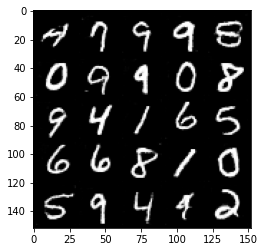

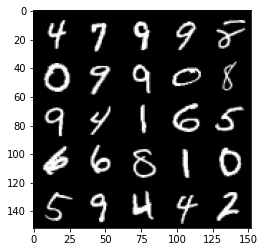

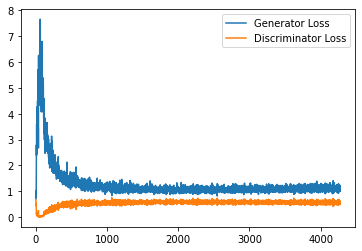

Step 86000: Generator loss: 1.1196015685796739, discriminator loss: 0.5604444556236267


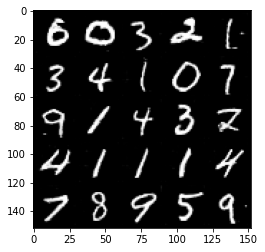

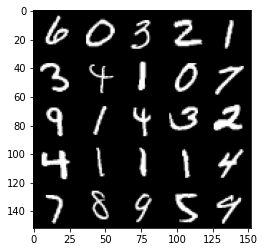

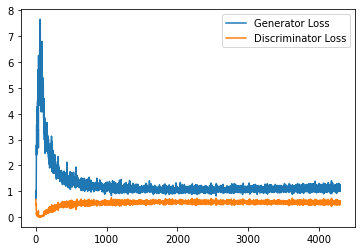

Step 86500: Generator loss: 1.1092144722938537, discriminator loss: 0.5590204554200172


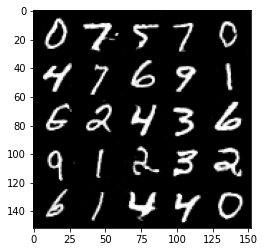

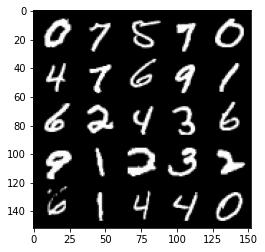

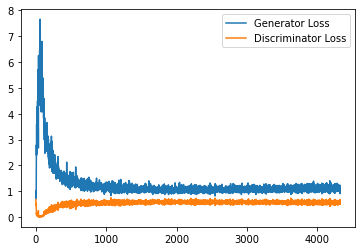

Step 87000: Generator loss: 1.1018052934408187, discriminator loss: 0.5594854534864425


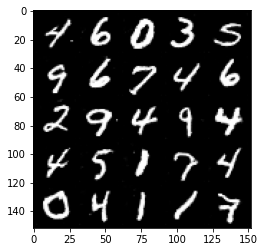

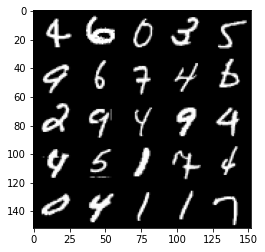

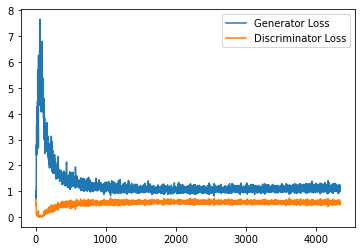

Step 87500: Generator loss: 1.1071715933084487, discriminator loss: 0.5629510504603386


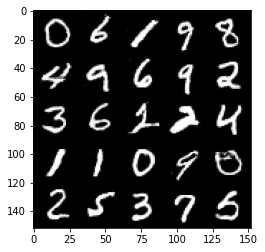

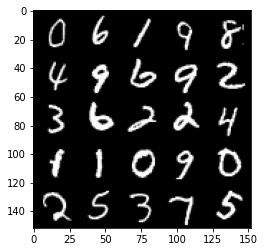

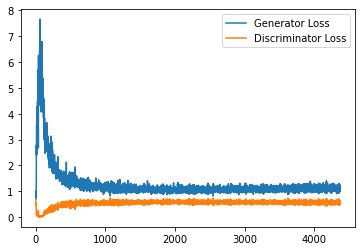

Step 88000: Generator loss: 1.114862847328186, discriminator loss: 0.5590926671624183


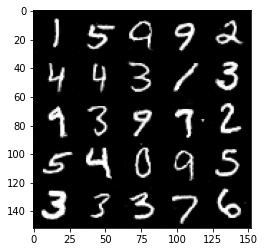

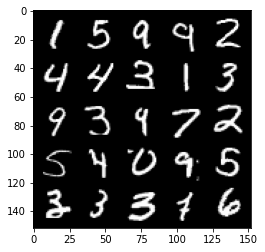

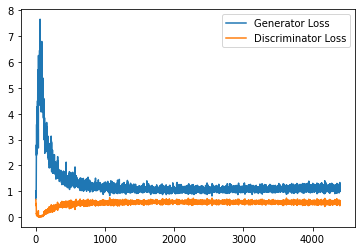

Step 88500: Generator loss: 1.1220169944763183, discriminator loss: 0.5615175923109055


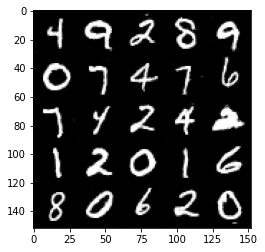

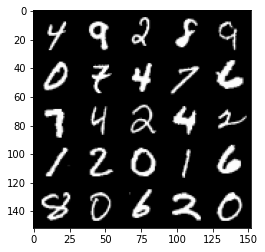

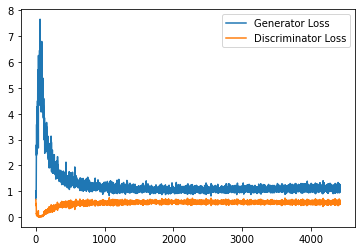

Step 89000: Generator loss: 1.1174490578174592, discriminator loss: 0.5591704731583595


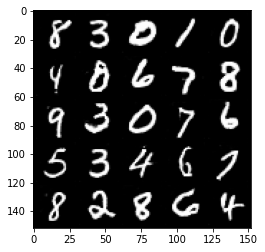

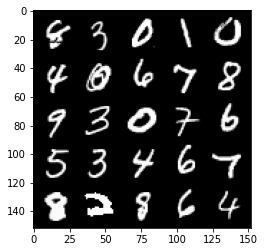

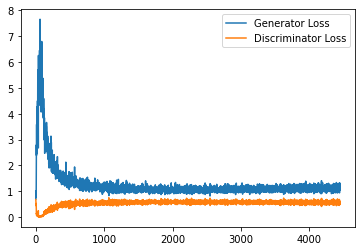

Step 89500: Generator loss: 1.1100919054746627, discriminator loss: 0.5634415994882583


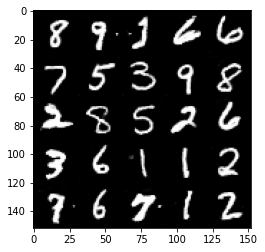

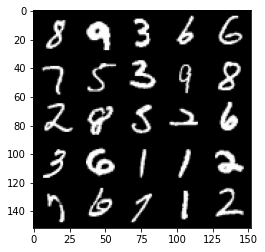

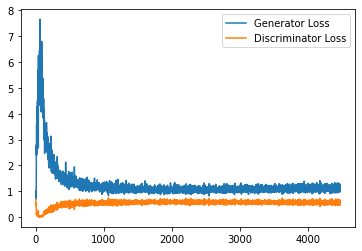

Step 90000: Generator loss: 1.1239053455591201, discriminator loss: 0.5602436770796776


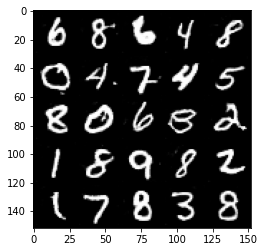

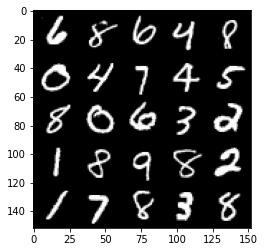

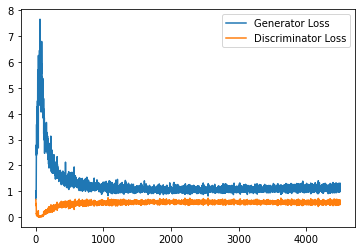

Step 90500: Generator loss: 1.1277166372537613, discriminator loss: 0.5582375705242157


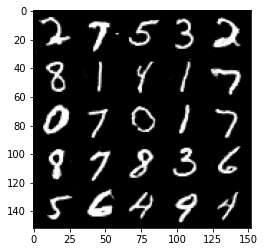

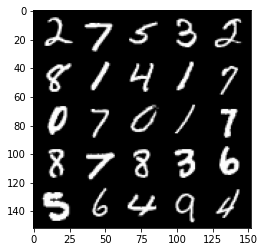

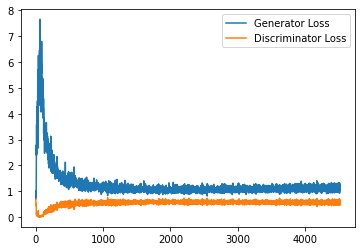

Step 91000: Generator loss: 1.1244777200222016, discriminator loss: 0.5571165199279785


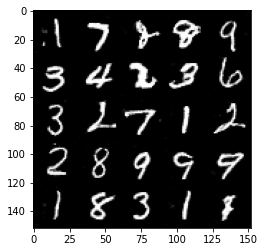

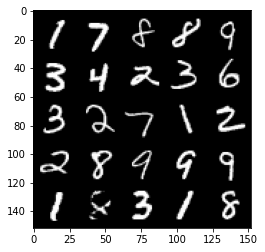

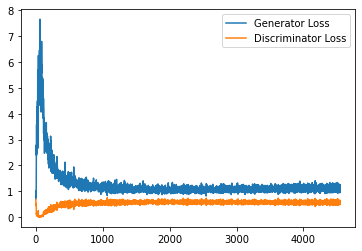

Step 91500: Generator loss: 1.13170656311512, discriminator loss: 0.5572933031916618


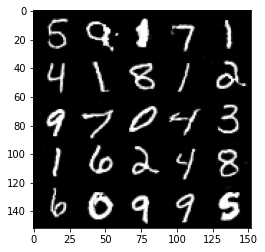

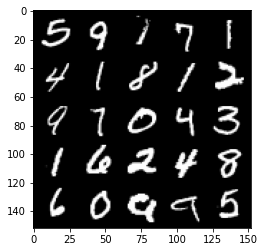

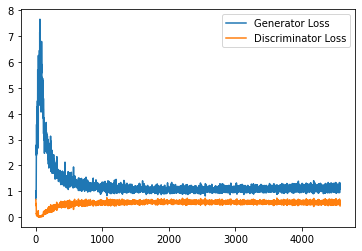

Step 92000: Generator loss: 1.109393593430519, discriminator loss: 0.5628207760453224


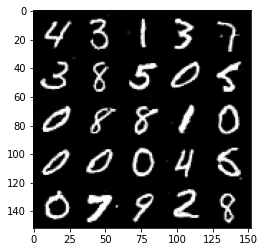

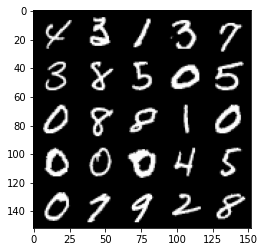

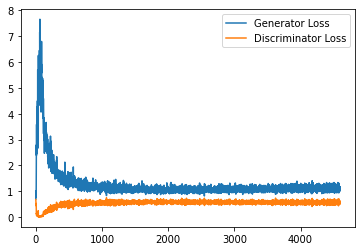

Step 92500: Generator loss: 1.115005024790764, discriminator loss: 0.5540038865208626


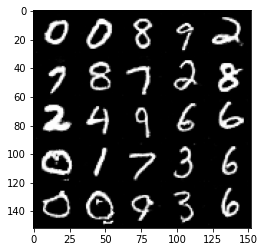

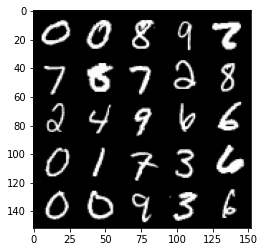

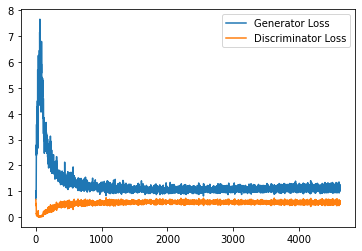

Step 93000: Generator loss: 1.1270109771490098, discriminator loss: 0.5557157787680626


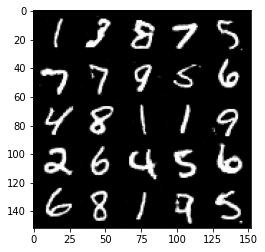

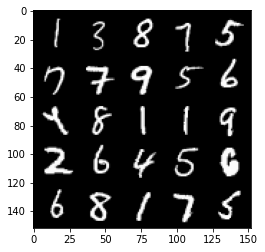

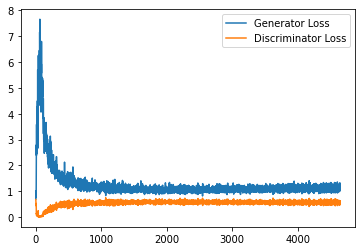

Step 93500: Generator loss: 1.131742250442505, discriminator loss: 0.5599392341375351


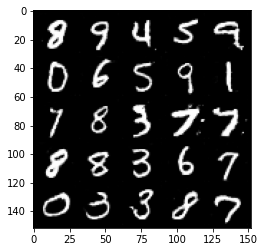

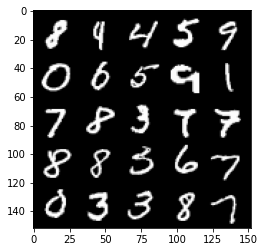

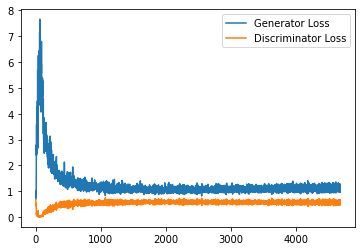

In [16]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [17]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

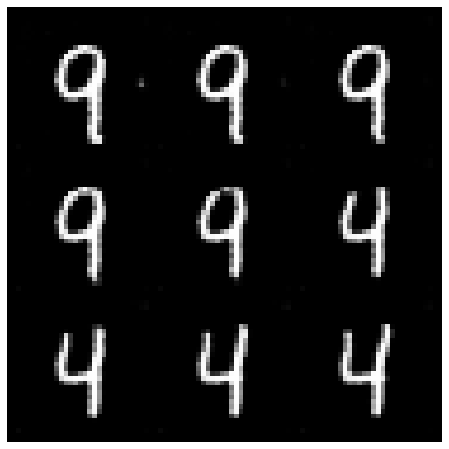

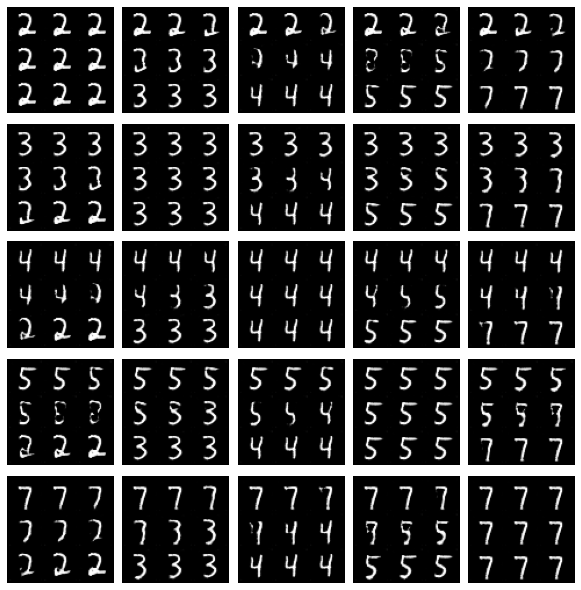

In [18]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 9 # Choose the start digit
### Change me! ###
end_plot_number = 4 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

## Uncomment the following lines of code if you would like to visualize a set of pairwise class 
## interpolations for a collection of different numbers, all in a single grid of interpolations.
## You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

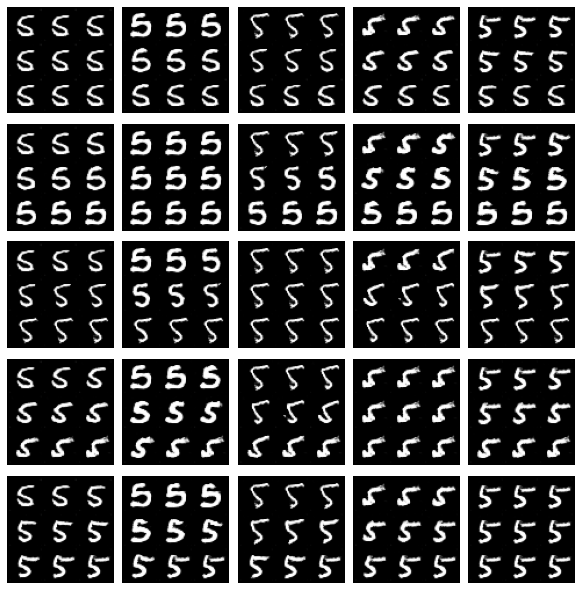

In [19]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()